In [1]:
%matplotlib inline

import os
import time
import pandas as pd
import numpy as np
from scipy.io import mmread
import scipy.sparse as sp
import matplotlib.pyplot as plt
from IPython.display import Image
import scanpy as sc
import anndata as ad
from scipy.sparse import csr_matrix
import logging

from cnmf import cNMF

#from skbio.stats.composition import clr

import matplotlib.pyplot as plt
import matplotlib.axes as axes
#For CLR of ADTs
import scipy
import scipy.stats
from sklearn.preprocessing import scale

BILLING_PROJECT_ID = os.environ['WORKSPACE_NAMESPACE']
WORKSPACE = os.environ['WORKSPACE_NAME']
bucket = os.environ['WORKSPACE_BUCKET']

sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')

2024-07-19 18:41:27.192731: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-07-19 18:41:58.427323: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/cuda/lib64:/usr/local/cuda/lib:/usr/local/lib/x86_64-linux-gnu:/usr/local/nvidia/lib:/usr/local/nvidia/lib64:/usr/local/nvidia/lib:/usr/local/nvidia/lib64
2024-07-19 18:41:58.503038: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such 

scanpy==1.10.1 anndata==0.10.7 umap==0.5.6 numpy==1.24.4 scipy==1.13.0 pandas==2.0.3 scikit-learn==1.3.0 statsmodels==0.14.0 pynndescent==0.5.12


In [2]:
#!gsutil cp $bucket/cellranger_output_directory/bladder/harmony/non_harmonized_urothelial_only_raw_for_cNMF.h5ad .
#!gsutil cp $bucket/cellranger_output_directory/bladder/BLAD1029/doublet_removed.h5ad .
adata = sc.read_h5ad("cnmf_urothelial.h5ad")
adata #only Urothelial subset

AnnData object with n_obs × n_vars = 30333 × 2000
    obs: 'doublet_score', 'predicted_doublet', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_mt', 'pct_counts_mt', 'platelet', 'RBC', 'batch', 'n_counts', 'Usage_1', 'Usage_2', 'Usage_3', 'Usage_4', 'Usage_5', 'Usage_6', 'Usage_7', 'response'
    var: 'mt', 'ribo', 'n_cells', 'mean', 'std'
    uns: 'batch_colors', 'cluster_colors', 'neighbors', 'pca', 'response_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

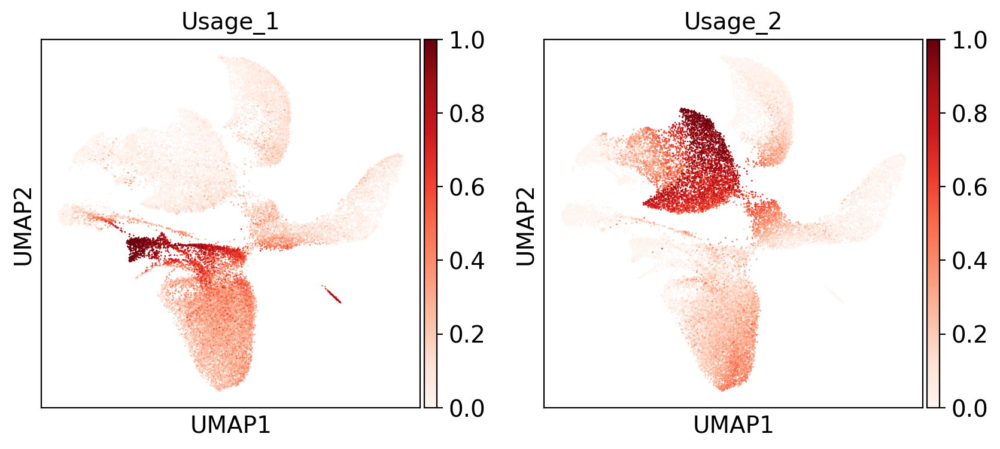

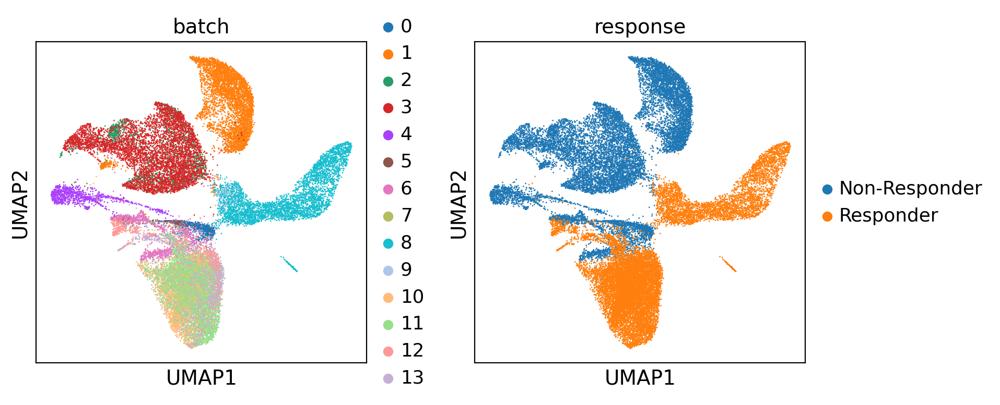

In [3]:
sc.set_figure_params(dpi=100, color_map = 'Reds')
sc.pl.umap(adata, color=['Usage_1','Usage_2'],
           use_raw=True, ncols=3, vmin=0, vmax=1)
sc.pl.umap(adata, color = ['batch', 'response'])#, save="cNMF_batch")

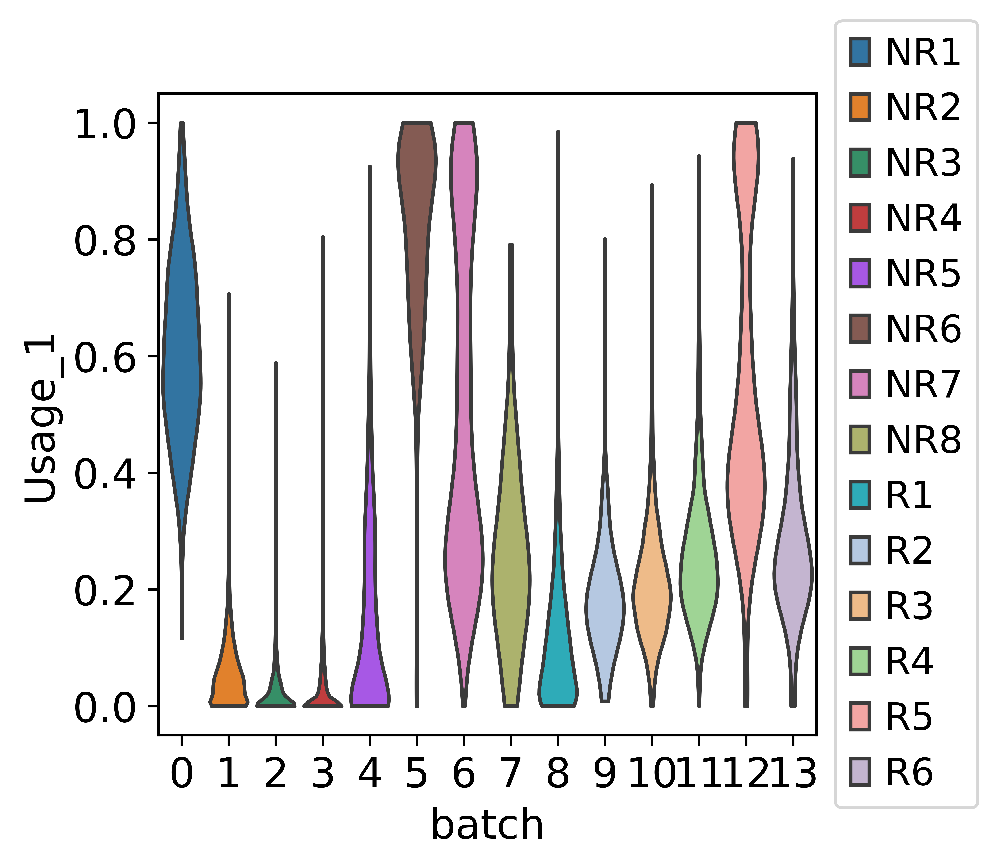

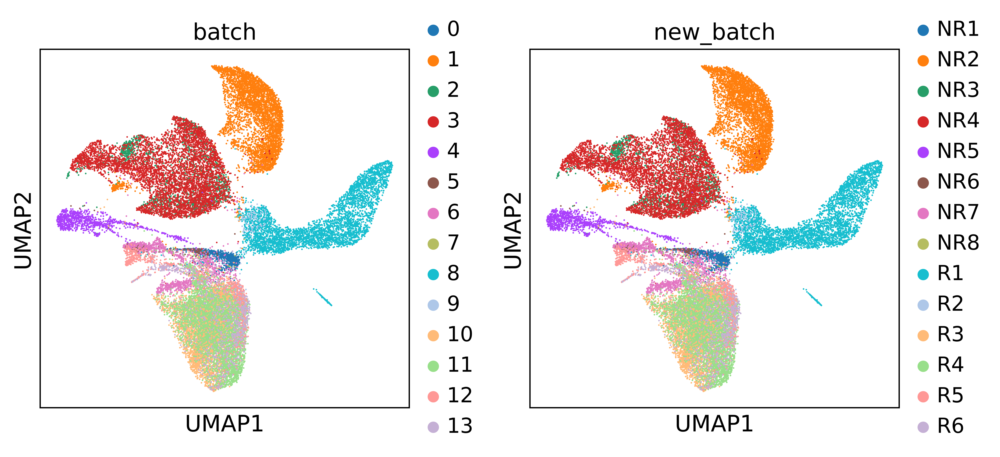

In [6]:
sc.settings.set_figure_params(dpi=500, facecolor='white')
fig, ax = plt.subplots()

sc.pl.violin(adata, ['Usage_1','Usage_2','Usage_3','Usage_4','Usage_5','Usage_6','Usage_7'], 
             groupby= 'batch', log=False, use_raw=None, stripplot=False, jitter=False, size=3, 
             layer=None, scale='width', order=None, multi_panel=None, xlabel='', ylabel=None, 
             rotation=None, show=False, save=None, ax=ax)
#ax.set_ylim(0, 2)
plt.legend(['NR1','NR2','NR3','NR4','NR5','NR6','NR7','NR8','R1','R2','R3','R4','R5','R6'],
           loc='center left', bbox_to_anchor=(1.0, 0.5), ncol = 1) 
plt.grid(False)
plt.show()



batch_name = {'0':'NR1','1':'NR2','2':'NR3','3':'NR4','4':'NR5','5':'NR6','6':'NR7','7':'NR8',
              '8':'R1','9':'R2','10':'R3','11':'R4','12':'R5','13':'R6'}
adata.obs['new_batch'] = adata.obs['batch'].map(batch_name)
sc.pl.umap(adata, color = ['batch','new_batch'])#, save="cNMF_batch")


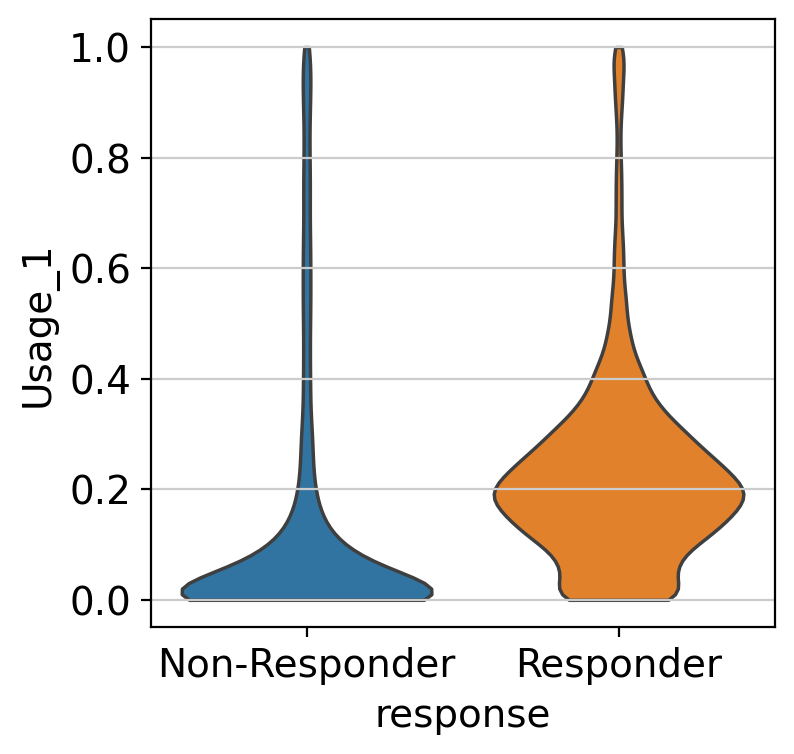

In [5]:
fig, ax = plt.subplots()

sc.pl.violin(adata, ['Usage_1','Usage_2','Usage_3','Usage_4','Usage_5','Usage_6','Usage_7'], 
             groupby= 'response', log=False, use_raw=None, stripplot=False, jitter=False, size=3, 
             layer=None, scale='width', order=None, multi_panel=None, xlabel='', ylabel=None, 
             rotation=None, show=False, save=None, ax=ax)
#ax.set_ylim(0, 2)

plt.show()

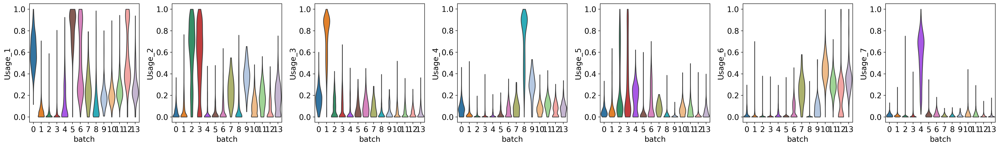

In [5]:
%matplotlib inline
from matplotlib import pyplot as plt
plt.rcParams["axes.grid"] = False
sc.pl.violin(adata, ['Usage_1','Usage_2','Usage_3','Usage_4','Usage_5','Usage_6','Usage_7'], 
             groupby= 'batch', log=False, use_raw=None, stripplot=False, jitter=False, size=3, 
             layer=None, scale='width', order=None, multi_panel=None, xlabel='', ylabel=None, 
             rotation=None, show=None, save=None, ax=None)


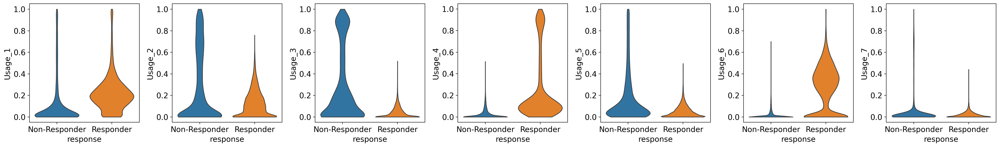

In [6]:
%matplotlib inline
from matplotlib import pyplot as plt
plt.rcParams["axes.grid"] = False
sc.pl.violin(adata, ['Usage_1','Usage_2','Usage_3','Usage_4','Usage_5','Usage_6','Usage_7'], 
             groupby= 'response', log=False, use_raw=None, stripplot=False, jitter=False, size=3, 
             layer=None, scale='width', order=None, multi_panel=None, xlabel='', ylabel=None, 
             rotation=None, show=None, save=None, ax=None)

In [48]:
adata.obs

,doublet_score,predicted_doublet,n_genes,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,total_counts_mito,log1p_total_counts_mito,pct_counts_mito,...,Usage_1,Usage_2,Usage_3,Usage_4,Usage_5,Usage_6,Usage_7,response,Usage,usagenum
GACCTGCAGCCACATG-1-0,0.286375,False,8854,9947,9.205127,50461.0,10.828976,1334.0,7.196687,2.643626,...,0.583531,0.060630,0.181815,0.092860,0.040639,0.000000,0.040524,Non-Responder,Usage_1,1
GCTTACCTCTTGACCC-1-0,0.294673,False,7847,8651,9.065546,37051.0,10.520078,934.0,6.840547,2.520849,...,0.634282,0.078768,0.148861,0.071451,0.027413,0.022825,0.016400,Non-Responder,Usage_1,1
AGGTATTGTAGTTGGC-1-0,0.256236,False,6287,6686,8.807921,24483.0,10.105775,448.0,6.107023,1.829841,...,0.444710,0.115435,0.128665,0.165192,0.126532,0.000049,0.019418,Non-Responder,Usage_1,1
CAACTAATCGCTAGTG-1-0,0.341772,False,6754,7406,8.910181,21485.0,9.975157,766.0,6.642487,3.565278,...,0.710238,0.043686,0.105071,0.051342,0.040721,0.020234,0.028708,Non-Responder,Usage_1,1
GTTACGCCAAATGCCC-1-0,0.341772,False,6182,6817,8.827321,20956.0,9.950228,543.0,6.298949,2.591143,...,0.706026,0.016839,0.201577,0.048736,0.024469,0.000000,0.002353,Non-Responder,Usage_1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GCTTAACAGAGGCTAA-1-13,0.158111,False,204,220,5.398163,278.0,5.631212,9.0,2.302585,3.237410,...,0.286261,0.273423,0.003181,0.061121,0.000000,0.376014,0.000000,Responder,Usage_6,6
ACCTGTTGTACGATTG-1-13,0.332840,False,224,235,5.463832,261.0,5.568345,2.0,1.098612,0.766284,...,0.521627,0.000000,0.015803,0.098654,0.103811,0.236057,0.024047,Responder,Usage_1,1
GGTTGGTGTCAACAAT-1-13,0.132545,False,210,227,5.429346,247.0,5.513429,1.0,0.693147,0.404858,...,0.516353,0.059316,0.000000,0.076922,0.038327,0.309084,0.000000,Responder,Usage_1,1
TGAAGGATCGGGACTC-1-13,0.040681,False,217,234,5.459586,266.0,5.587249,2.0,1.098612,0.751880,...,0.077785,0.056757,0.324110,0.145788,0.000000,0.395561,0.000000,Responder,Usage_6,6


In [12]:
adata.obs

,doublet_score,predicted_doublet,n_genes,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,total_counts_mito,log1p_total_counts_mito,pct_counts_mito,...,n_counts,Usage_1,Usage_2,Usage_3,Usage_4,Usage_5,Usage_6,Usage_7,response,Usage
GACCTGCAGCCACATG-1-0,0.286375,False,8854,9947,9.205127,50461.0,10.828976,1334.0,7.196687,2.643626,...,45654.0,0.583531,0.060630,0.181815,0.092860,0.040639,0.000000,0.040524,Non-Responder,Usage_1
GCTTACCTCTTGACCC-1-0,0.294673,False,7847,8651,9.065546,37051.0,10.520078,934.0,6.840547,2.520849,...,33304.0,0.634282,0.078768,0.148861,0.071451,0.027413,0.022825,0.016400,Non-Responder,Usage_1
AGGTATTGTAGTTGGC-1-0,0.256236,False,6287,6686,8.807921,24483.0,10.105775,448.0,6.107023,1.829841,...,22591.0,0.444710,0.115435,0.128665,0.165192,0.126532,0.000049,0.019418,Non-Responder,Usage_1
CAACTAATCGCTAGTG-1-0,0.341772,False,6754,7406,8.910181,21485.0,9.975157,766.0,6.642487,3.565278,...,19063.0,0.710238,0.043686,0.105071,0.051342,0.040721,0.020234,0.028708,Non-Responder,Usage_1
GTTACGCCAAATGCCC-1-0,0.341772,False,6182,6817,8.827321,20956.0,9.950228,543.0,6.298949,2.591143,...,18433.0,0.706026,0.016839,0.201577,0.048736,0.024469,0.000000,0.002353,Non-Responder,Usage_1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GCTTAACAGAGGCTAA-1-13,0.158111,False,204,220,5.398163,278.0,5.631212,9.0,2.302585,3.237410,...,235.0,0.286261,0.273423,0.003181,0.061121,0.000000,0.376014,0.000000,Responder,Usage_6
ACCTGTTGTACGATTG-1-13,0.332840,False,224,235,5.463832,261.0,5.568345,2.0,1.098612,0.766284,...,239.0,0.521627,0.000000,0.015803,0.098654,0.103811,0.236057,0.024047,Responder,Usage_1
GGTTGGTGTCAACAAT-1-13,0.132545,False,210,227,5.429346,247.0,5.513429,1.0,0.693147,0.404858,...,225.0,0.516353,0.059316,0.000000,0.076922,0.038327,0.309084,0.000000,Responder,Usage_1
TGAAGGATCGGGACTC-1-13,0.040681,False,217,234,5.459586,266.0,5.587249,2.0,1.098612,0.751880,...,238.0,0.077785,0.056757,0.324110,0.145788,0.000000,0.395561,0.000000,Responder,Usage_6


In [10]:
df = adata.obs[['Usage_1','Usage_2','Usage_3','Usage_4','Usage_5','Usage_6','Usage_7']]

In [11]:
adata.obs['Usage'] = df.idxmax(axis=1)

In [13]:
adata.obs['usagenum'] = adata.obs['Usage'].str[-1:]
adata.obs.usagenum.unique()
len(adata.obs['usagenum'].unique())

7

In [17]:
leiden_prop = dict()
no_clusters = len(adata.obs['batch'].unique())
for sn in adata.obs['Usage'].unique():
    temp = adata[adata.obs['Usage'] == sn,:]
    cell_count = temp.obs['batch'].value_counts()
    cell_count = cell_count.sort_index()
    cell_count = cell_count.to_dict()
    cell_count = [cell_count[str(x)] if str(x) in cell_count.keys() else 0 for x in range(0,no_clusters)]
    leiden_prop[sn] = cell_count

leiden_prop = pd.DataFrame(leiden_prop).T

leiden_prop['total'] = leiden_prop.sum(axis = 1)
leiden_prct = pd.DataFrame()
for x in leiden_prop.columns:
    leiden_prct[x] = leiden_prop[x]/leiden_prop[x].sum()
leiden_prct = leiden_prct.sort_index()

leiden_prct


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,total
Usage_1,0.978036,0.002575,0.001914,0.000573,0.140196,0.973568,0.682305,0.333333,0.049579,0.107143,0.097625,0.273850,0.799787,0.262662,0.157518
Usage_2,0.001292,0.027039,0.734525,0.684693,0.013725,0.004405,0.037037,0.274510,0.083755,0.589286,0.018163,0.168725,0.037274,0.150766,0.206310
Usage_3,0.016796,0.951717,0.001276,0.010892,0.016667,0.000000,0.029630,0.039216,0.000481,0.000000,0.001572,0.003942,0.000000,0.004711,0.151386
Usage_4,0.000000,0.000215,0.000000,0.000000,0.000000,0.000000,0.003292,0.019608,0.865704,0.285714,0.001572,0.010250,0.001065,0.000000,0.121452
Usage_5,0.003876,0.017597,0.261008,0.303077,0.022549,0.022026,0.233745,0.000000,0.000241,0.000000,0.002620,0.006307,0.002130,0.005889,0.080407
Usage_6,0.000000,0.000858,0.000638,0.000573,0.000980,0.000000,0.013992,0.333333,0.000241,0.017857,0.878275,0.536925,0.159744,0.575972,0.255728
Usage_7,0.000000,0.000000,0.000638,0.000191,0.805882,0.000000,0.000000,0.000000,0.000000,0.000000,0.000175,0.000000,0.000000,0.000000,0.027198


In [20]:
leiden_prct=leiden_prct.set_axis([
             'NR1',
             'NR2',
             'NR3',
             'NR4',
             'NR5',
             'NR6',
             'NR7',
             'NR8',
             'R1',
             'R2',
             'R3',
             'R4',
             'R5',
             'R6'
    ,'total'], axis="columns")#, inplace=True)

leiden_prct


,NR1,NR2,NR3,NR4,NR5,NR6,NR7,NR8,R1,R2,R3,R4,R5,R6,total
Usage_1,0.978036,0.002575,0.001914,0.000573,0.140196,0.973568,0.682305,0.333333,0.049579,0.107143,0.097625,0.273850,0.799787,0.262662,0.157518
Usage_2,0.001292,0.027039,0.734525,0.684693,0.013725,0.004405,0.037037,0.274510,0.083755,0.589286,0.018163,0.168725,0.037274,0.150766,0.206310
Usage_3,0.016796,0.951717,0.001276,0.010892,0.016667,0.000000,0.029630,0.039216,0.000481,0.000000,0.001572,0.003942,0.000000,0.004711,0.151386
Usage_4,0.000000,0.000215,0.000000,0.000000,0.000000,0.000000,0.003292,0.019608,0.865704,0.285714,0.001572,0.010250,0.001065,0.000000,0.121452
Usage_5,0.003876,0.017597,0.261008,0.303077,0.022549,0.022026,0.233745,0.000000,0.000241,0.000000,0.002620,0.006307,0.002130,0.005889,0.080407
Usage_6,0.000000,0.000858,0.000638,0.000573,0.000980,0.000000,0.013992,0.333333,0.000241,0.017857,0.878275,0.536925,0.159744,0.575972,0.255728
Usage_7,0.000000,0.000000,0.000638,0.000191,0.805882,0.000000,0.000000,0.000000,0.000000,0.000000,0.000175,0.000000,0.000000,0.000000,0.027198


Text(0.5, 0, 'Samples')

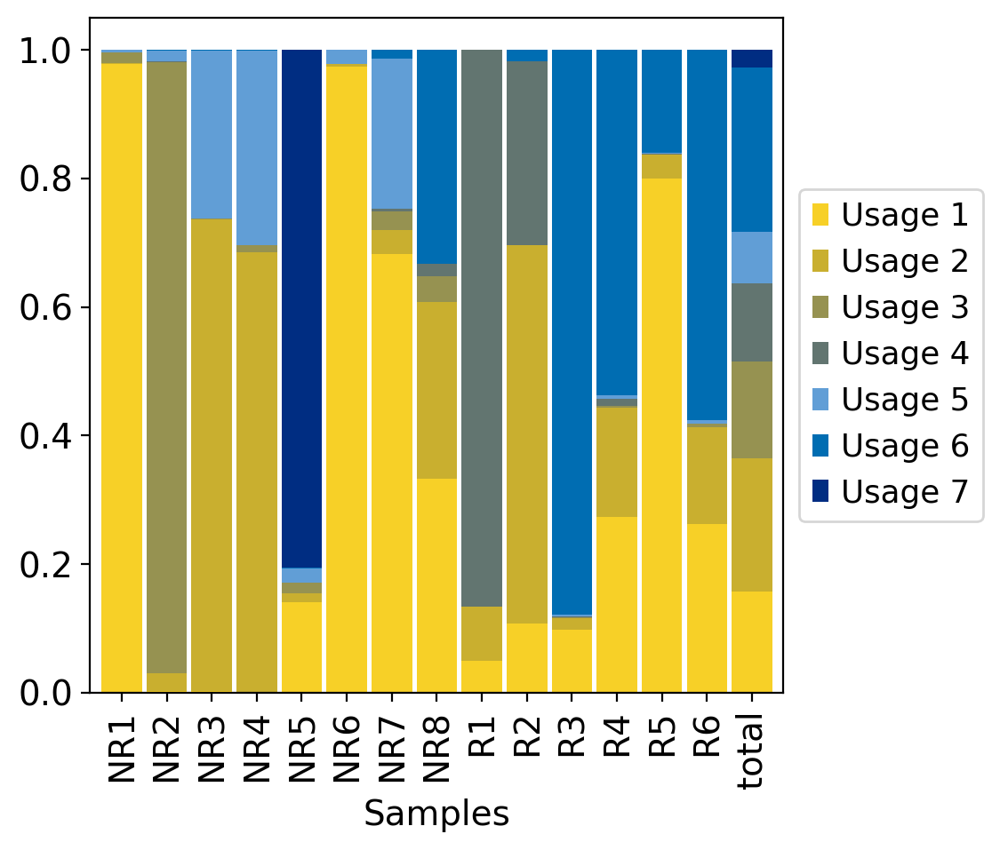

In [54]:

leiden_prct.T.plot.bar(stacked=True, legend = False,figsize=(5,5),width=0.9,  
                       color=["#f7d027",
                              "#C9AF2F",
                              "#969251",                          
                              "#627570",
                              "#619ed6",
                              "#006db2",
                              "#002d82"])
plt.legend(['Usage 1','Usage 2','Usage 3','Usage 4','Usage 5','Usage 6','Usage 7'],
           loc='center left', bbox_to_anchor=(1.0, 0.5), ncol = 1) 
plt.grid(False)
plt.xlabel('Samples')





In [22]:
df1= leiden_prct[['R1','R2','R3','R4','R5','R6']]
df1

,R1,R2,R3,R4,R5,R6
Usage_1,0.049579,0.107143,0.097625,0.273850,0.799787,0.262662
Usage_2,0.083755,0.589286,0.018163,0.168725,0.037274,0.150766
Usage_3,0.000481,0.000000,0.001572,0.003942,0.000000,0.004711
Usage_4,0.865704,0.285714,0.001572,0.010250,0.001065,0.000000
Usage_5,0.000241,0.000000,0.002620,0.006307,0.002130,0.005889
Usage_6,0.000241,0.017857,0.878275,0.536925,0.159744,0.575972
Usage_7,0.000000,0.000000,0.000175,0.000000,0.000000,0.000000


In [23]:
df2 = leiden_prct[['NR1',
             'NR2',
             'NR3',
             'NR4',
             'NR5',
             'NR6',
             'NR7',
             'NR8',]]
df2


,NR1,NR2,NR3,NR4,NR5,NR6,NR7,NR8
Usage_1,0.978036,0.002575,0.001914,0.000573,0.140196,0.973568,0.682305,0.333333
Usage_2,0.001292,0.027039,0.734525,0.684693,0.013725,0.004405,0.037037,0.274510
Usage_3,0.016796,0.951717,0.001276,0.010892,0.016667,0.000000,0.029630,0.039216
Usage_4,0.000000,0.000215,0.000000,0.000000,0.000000,0.000000,0.003292,0.019608
Usage_5,0.003876,0.017597,0.261008,0.303077,0.022549,0.022026,0.233745,0.000000
Usage_6,0.000000,0.000858,0.000638,0.000573,0.000980,0.000000,0.013992,0.333333
Usage_7,0.000000,0.000000,0.000638,0.000191,0.805882,0.000000,0.000000,0.000000


In [25]:
from scipy.stats import ranksums


responder=df1#.reorder(index = {'0':'T', '1':'T-memory', '2':'NK', '3':'B','4':'Plasma','5':'Mast','6':'Macro','7':'Mono'})
responder


non_responder=df2#.reorder(index = {'0':'T', '1':'T-memory', '2':'NK', '3':'B','4':'Plasma','5':'Mast','6':'Macro','7':'Mono'})
non_responder


sample1 = responder.T['Usage_1'].to_numpy()
print(sample1)

sample2 = non_responder.T['Usage_1'].to_numpy()
print(sample2)


print(ranksums(sample1, sample2))


ranksums(responder.T['Usage_1'], non_responder.T['Usage_1'])


[0.04957882 0.10714286 0.09762487 0.2738502  0.79978701 0.26266196]
[9.78036176e-01 2.57510730e-03 1.91448628e-03 5.73284923e-04
 1.40196078e-01 9.73568282e-01 6.82304527e-01 3.33333333e-01]
RanksumsResult(statistic=-0.12909944487358055, pvalue=0.897278961260083)


RanksumsResult(statistic=-0.12909944487358055, pvalue=0.897278961260083)

In [42]:
ranksums(responder.T['Usage_1'], non_responder.T['Usage_1'])


RanksumsResult(statistic=-0.12909944487358055, pvalue=0.897278961260083)

In [26]:
ranksums(responder.T['Usage_2'], non_responder.T['Usage_2'])


RanksumsResult(statistic=0.6454972243679028, pvalue=0.5186050164287256)

In [27]:
ranksums(responder.T['Usage_3'], non_responder.T['Usage_3'])


RanksumsResult(statistic=-2.065591117977289, pvalue=0.03886710381241724)

In [28]:
ranksums(responder.T['Usage_4'], non_responder.T['Usage_4'])


RanksumsResult(statistic=1.7428425057933374, pvalue=0.08136112923407546)

In [29]:
ranksums(responder.T['Usage_5'], non_responder.T['Usage_5'])


RanksumsResult(statistic=-2.130140840414079, pvalue=0.03315998745884777)

In [30]:
ranksums(responder.T['Usage_6'], non_responder.T['Usage_6'])


RanksumsResult(statistic=2.065591117977289, pvalue=0.03886710381241724)

In [31]:
ranksums(responder.T['Usage_7'], non_responder.T['Usage_7'])


RanksumsResult(statistic=-0.8391463916782737, pvalue=0.40138716571176614)

In [56]:
adata.obs['usagenum'] = adata.obs['Usage'].str[-1:]
adata.obs.usagenum.unique()
len(adata.obs['usagenum'].unique())

7

In [57]:
leiden_prop = dict()
no_clusters = len(adata.obs['usagenum'].unique())
for sn in adata.obs['response'].unique():
    temp = adata[adata.obs['response'] == sn,:]
    cell_count = temp.obs['usagenum'].value_counts()
    cell_count = cell_count.sort_index()
    cell_count = cell_count.to_dict()
    cell_count = [cell_count[str(x)] if str(x) in cell_count.keys() else 0 for x in range(1,no_clusters+1)]
    leiden_prop[sn] = cell_count

In [58]:
temp = adata[adata.obs['response'] == sn,:]
cell_count = temp.obs['usagenum'].value_counts()
cell_count = cell_count.sort_index()
cell_count = cell_count.to_dict()

cell_count

{'1': 2793, '2': 1323, '3': 30, '4': 3678, '5': 47, '6': 7714, '7': 1}

In [60]:
[cell_count[str(x)] if str(x) in cell_count.keys() else 0 for x in range(1,no_clusters+1)]
#cell_count

[2793, 1323, 30, 3678, 47, 7714, 1]

In [ ]:
temp = adata[adata.obs['response'] == sn,:]
cell_count = temp.obs['usagenum'].value_counts()
cell_count = cell_count.sort_index()
cell_count = cell_count.to_dict()
cell_count = [cell_count[str(x)] if str(x) in cell_count.keys() else 0 for x in range(0,no_clusters)]
cell_count

In [59]:
leiden_prop = pd.DataFrame(leiden_prop).T
leiden_prop

,0,1,2,3,4,5,6
Non-Responder,1985,4935,4562,6,2392,43,824
Responder,2793,1323,30,3678,47,7714,1


In [60]:
leiden_prop['total'] = leiden_prop.sum(axis = 1)
leiden_prct = pd.DataFrame()
for x in leiden_prop.columns:
    leiden_prct[x] = leiden_prop[x]/leiden_prop[x].sum()
leiden_prct = leiden_prct.sort_index()

In [61]:
leiden_prct

,0,1,2,3,4,5,6,total
Non-Responder,0.415446,0.788591,0.993467,0.001629,0.98073,0.005543,0.998788,0.48617
Responder,0.584554,0.211409,0.006533,0.998371,0.01927,0.994457,0.001212,0.51383


In [62]:
leiden_prct=leiden_prct.set_axis([
             'Usage1',
             'Usage2',
             'Usage3',
             'Usage4',
             'Usage5',
             'Usage6',
             'Usage7'
             
    ,'total'], axis="columns")#, inplace=True)

In [63]:
leiden_prct

,Usage1,Usage2,Usage3,Usage4,Usage5,Usage6,Usage7,total
Non-Responder,0.415446,0.788591,0.993467,0.001629,0.98073,0.005543,0.998788,0.48617
Responder,0.584554,0.211409,0.006533,0.998371,0.01927,0.994457,0.001212,0.51383


Text(0.5, 0, 'Usage')

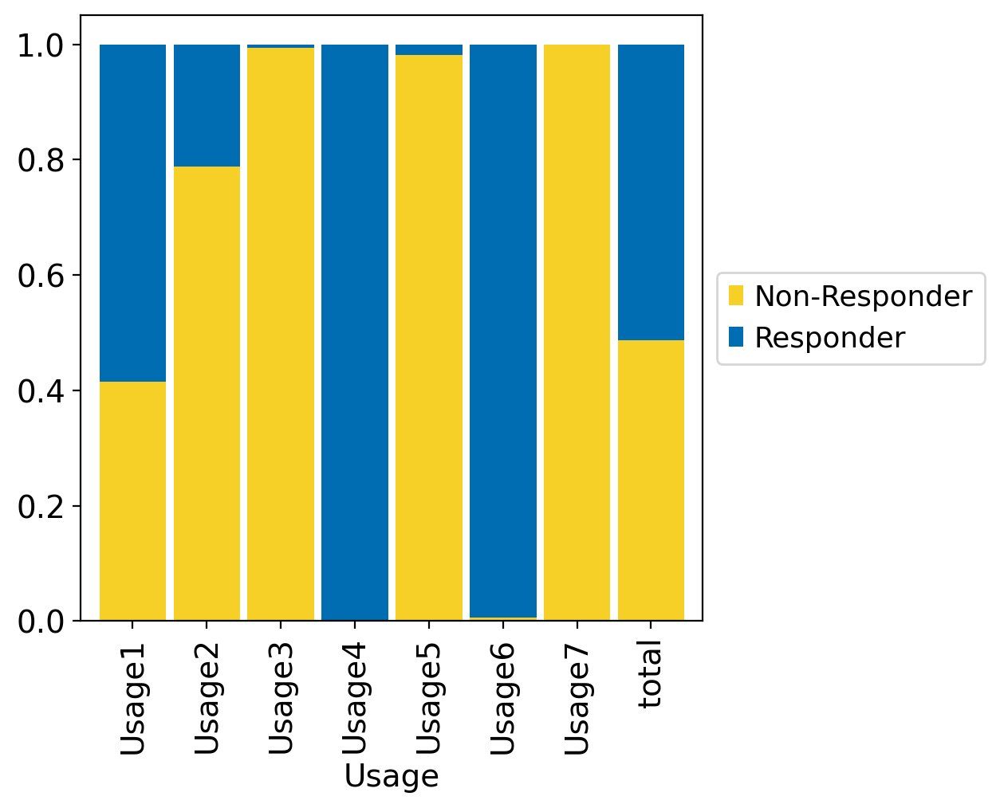

In [71]:
leiden_prct.T.plot.bar(stacked=True, legend = False,figsize=(5,5),width=0.9,
                       color=["#f7d027",
                                  #"#C9AF2F",
                                  #"#969251",                          
                                  #"#627570",
                              #"#619ed6",
                              "#006db2"
                                  #"#002d82"
                             ])
plt.legend(['Non-Responder','Responder'],
           loc='center left', bbox_to_anchor=(1.0, 0.5), ncol = 1) 
plt.grid(False)
plt.xlabel('Usage')




Text(0.5, 0, 'Usage')

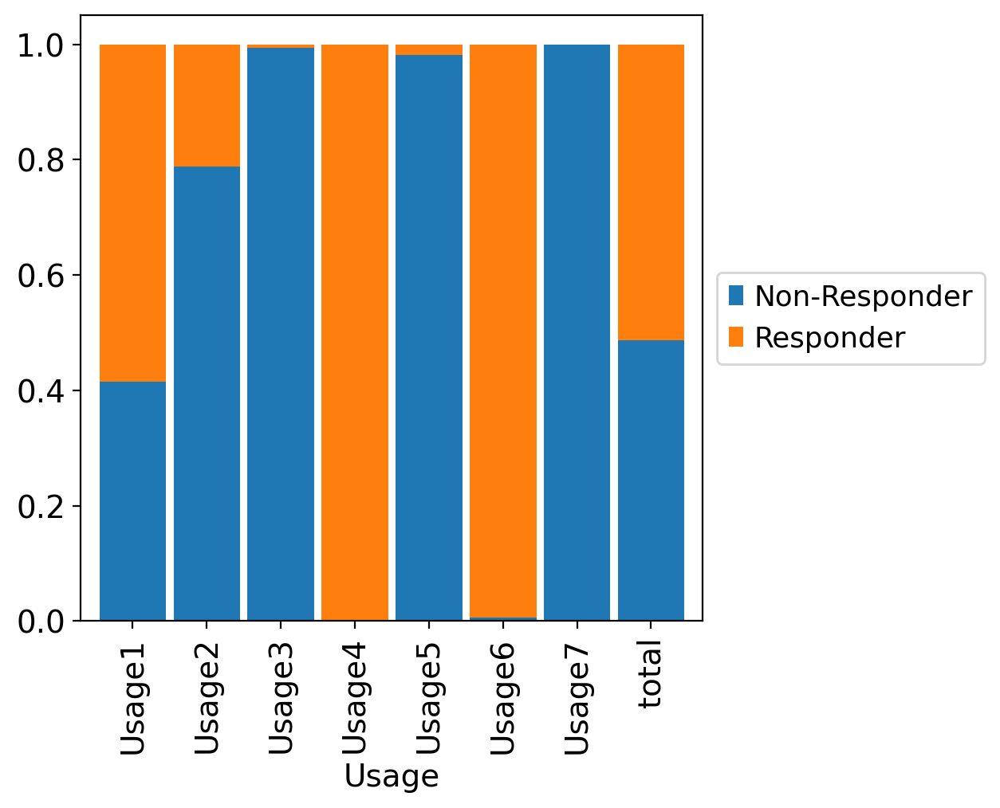

In [72]:
leiden_prct.T.plot.bar(stacked=True, legend = False,figsize=(5,5),width=0.9)
plt.legend(['Non-Responder','Responder'],
           loc='center left', bbox_to_anchor=(1.0, 0.5), ncol = 1) 
plt.grid(False)
plt.xlabel('Usage')




In [75]:
leiden_prop = dict()
no_clusters = len(adata.obs['batch'].unique())
for sn in adata.obs['Usage'].unique():
    temp = adata[adata.obs['Usage'] == sn,:]
    cell_count = temp.obs['batch'].value_counts()
    cell_count = cell_count.sort_index()
    cell_count = cell_count.to_dict()
    cell_count = [cell_count[str(x)] if str(x) in cell_count.keys() else 0 for x in range(0,no_clusters)]
    leiden_prop[sn] = cell_count

In [76]:
leiden_prop

{'Usage_1': [757, 12, 3, 3, 143, 221, 829, 17, 206, 12, 559, 1042, 751, 223],
 'Usage_5': [3, 82, 409, 1586, 23, 5, 284, 0, 1, 0, 15, 24, 2, 5],
 'Usage_3': [13, 4435, 2, 57, 17, 0, 36, 2, 2, 0, 9, 15, 0, 4],
 'Usage_2': [1, 126, 1151, 3583, 14, 1, 45, 14, 348, 66, 104, 642, 35, 128],
 'Usage_6': [0, 4, 1, 3, 1, 0, 17, 17, 1, 2, 5029, 2043, 150, 489],
 'Usage_4': [0, 1, 0, 0, 0, 0, 4, 1, 3597, 32, 9, 39, 1, 0],
 'Usage_7': [0, 0, 1, 1, 822, 0, 0, 0, 0, 0, 1, 0, 0, 0]}

In [77]:
leiden_prop = pd.DataFrame(leiden_prop).T

In [78]:
leiden_prop['total'] = leiden_prop.sum(axis = 1)
leiden_prct = pd.DataFrame()
for x in leiden_prop.columns:
    leiden_prct[x] = leiden_prop[x]/leiden_prop[x].sum()
leiden_prct = leiden_prct.sort_index()

In [83]:
leiden_prct=leiden_prct.set_axis([
             'NR1',
             'NR2',
             'NR3',
             'NR4',
             'NR5',
             'NR6',
             'NR7',
             'NR8',
             'R1',
             'R2',
             'R3',
             'R4',
             'R5',
             'R6'
    ,'total'], axis="columns")#, inplace=True)
leiden_prct

,NR1,NR2,NR3,NR4,NR5,NR6,NR7,NR8,R1,R2,R3,R4,R5,R6,total
Usage_1,0.978036,0.002575,0.001914,0.000573,0.140196,0.973568,0.682305,0.333333,0.049579,0.107143,0.097625,0.273850,0.799787,0.262662,0.157518
Usage_2,0.001292,0.027039,0.734525,0.684693,0.013725,0.004405,0.037037,0.274510,0.083755,0.589286,0.018163,0.168725,0.037274,0.150766,0.206310
Usage_3,0.016796,0.951717,0.001276,0.010892,0.016667,0.000000,0.029630,0.039216,0.000481,0.000000,0.001572,0.003942,0.000000,0.004711,0.151386
Usage_4,0.000000,0.000215,0.000000,0.000000,0.000000,0.000000,0.003292,0.019608,0.865704,0.285714,0.001572,0.010250,0.001065,0.000000,0.121452
Usage_5,0.003876,0.017597,0.261008,0.303077,0.022549,0.022026,0.233745,0.000000,0.000241,0.000000,0.002620,0.006307,0.002130,0.005889,0.080407
Usage_6,0.000000,0.000858,0.000638,0.000573,0.000980,0.000000,0.013992,0.333333,0.000241,0.017857,0.878275,0.536925,0.159744,0.575972,0.255728
Usage_7,0.000000,0.000000,0.000638,0.000191,0.805882,0.000000,0.000000,0.000000,0.000000,0.000000,0.000175,0.000000,0.000000,0.000000,0.027198


In [84]:
responder= leiden_prct[['R1','R2','R3','R4','R5','R6']]
non_responder= leiden_prct[['NR1',
             'NR2',
             'NR3',
             'NR4',
             'NR5',
             'NR6',
             'NR7',
             'NR8',]]

In [86]:
from scipy.stats import ranksums
ranksums(responder.T['Usage_1'], non_responder.T['Usage_1'])


RanksumsResult(statistic=-0.12909944487358055, pvalue=0.897278961260083)

In [87]:
ranksums(responder.T['Usage_2'], non_responder.T['Usage_2'])


RanksumsResult(statistic=0.6454972243679028, pvalue=0.5186050164287256)

In [88]:
ranksums(responder.T['Usage_3'], non_responder.T['Usage_3'])


RanksumsResult(statistic=-2.065591117977289, pvalue=0.03886710381241724)

In [89]:
ranksums(responder.T['Usage_4'], non_responder.T['Usage_4'])


RanksumsResult(statistic=1.7428425057933374, pvalue=0.08136112923407546)

In [90]:
ranksums(responder.T['Usage_5'], non_responder.T['Usage_5'])


RanksumsResult(statistic=-2.130140840414079, pvalue=0.03315998745884777)

In [91]:
ranksums(responder.T['Usage_6'], non_responder.T['Usage_6'])


RanksumsResult(statistic=2.065591117977289, pvalue=0.03886710381241724)

In [92]:
ranksums(responder.T['Usage_7'], non_responder.T['Usage_7'])

RanksumsResult(statistic=-0.8391463916782737, pvalue=0.40138716571176614)

In [9]:
adata.obs.columns

Index(['doublet_score', 'predicted_doublet', 'n_genes', 'n_genes_by_counts',
       'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts',
       'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito',
       'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo',
       'total_counts_mt', 'pct_counts_mt', 'platelet', 'RBC', 'batch',
       'n_counts', 'Usage_1', 'Usage_2', 'Usage_3', 'Usage_4', 'Usage_5',
       'Usage_6', 'Usage_7', 'response'],
      dtype='object')

In [12]:
df = adata.obs[['Usage_1','Usage_2','Usage_3','Usage_4','Usage_5','Usage_6','Usage_7']]

In [13]:
maxValues = df.max(axis=1)
print(maxValues)

GACCTGCAGCCACATG-1-0     0.583531
GCTTACCTCTTGACCC-1-0     0.634282
AGGTATTGTAGTTGGC-1-0     0.444710
CAACTAATCGCTAGTG-1-0     0.710238
GTTACGCCAAATGCCC-1-0     0.706026
                           ...   
GCTTAACAGAGGCTAA-1-13    0.376014
ACCTGTTGTACGATTG-1-13    0.521627
GGTTGGTGTCAACAAT-1-13    0.516353
TGAAGGATCGGGACTC-1-13    0.395561
AATTGACGTAGGTGTC-1-13    0.689781
Length: 30333, dtype: float64


In [14]:
maxValueIndex = df.idxmax(axis=1)
 
print("Max values of row are at following columns :")
print(maxValueIndex)

Max values of row are at following columns :
GACCTGCAGCCACATG-1-0     Usage_1
GCTTACCTCTTGACCC-1-0     Usage_1
AGGTATTGTAGTTGGC-1-0     Usage_1
CAACTAATCGCTAGTG-1-0     Usage_1
GTTACGCCAAATGCCC-1-0     Usage_1
                          ...   
GCTTAACAGAGGCTAA-1-13    Usage_6
ACCTGTTGTACGATTG-1-13    Usage_1
GGTTGGTGTCAACAAT-1-13    Usage_1
TGAAGGATCGGGACTC-1-13    Usage_6
AATTGACGTAGGTGTC-1-13    Usage_1
Length: 30333, dtype: object


In [15]:
adata.obs['Usage'] = df.idxmax(axis=1)

In [16]:
adata.obs[['batch','Usage']]

,batch,Usage
GACCTGCAGCCACATG-1-0,0,Usage_1
GCTTACCTCTTGACCC-1-0,0,Usage_1
AGGTATTGTAGTTGGC-1-0,0,Usage_1
CAACTAATCGCTAGTG-1-0,0,Usage_1
GTTACGCCAAATGCCC-1-0,0,Usage_1
...,...,...
GCTTAACAGAGGCTAA-1-13,13,Usage_6
ACCTGTTGTACGATTG-1-13,13,Usage_1
GGTTGGTGTCAACAAT-1-13,13,Usage_1
TGAAGGATCGGGACTC-1-13,13,Usage_6


In [20]:
plotdf

,Usage,n_genes,response,X_umap-0,X_umap-1
GACCTGCAGCCACATG-1-0,Usage_1,8854,Non-Responder,2.674785,1.983171
GCTTACCTCTTGACCC-1-0,Usage_1,7847,Non-Responder,2.637859,1.995018
AGGTATTGTAGTTGGC-1-0,Usage_1,6287,Non-Responder,3.152928,1.121663
CAACTAATCGCTAGTG-1-0,Usage_1,6754,Non-Responder,1.569780,1.929827
GTTACGCCAAATGCCC-1-0,Usage_1,6182,Non-Responder,2.117440,2.433784
...,...,...,...,...,...
GCTTAACAGAGGCTAA-1-13,Usage_6,204,Responder,1.984699,-2.008764
ACCTGTTGTACGATTG-1-13,Usage_1,224,Responder,-1.871732,1.147735
GGTTGGTGTCAACAAT-1-13,Usage_1,210,Responder,3.260756,-3.001302
TGAAGGATCGGGACTC-1-13,Usage_6,217,Responder,4.366323,-2.272059


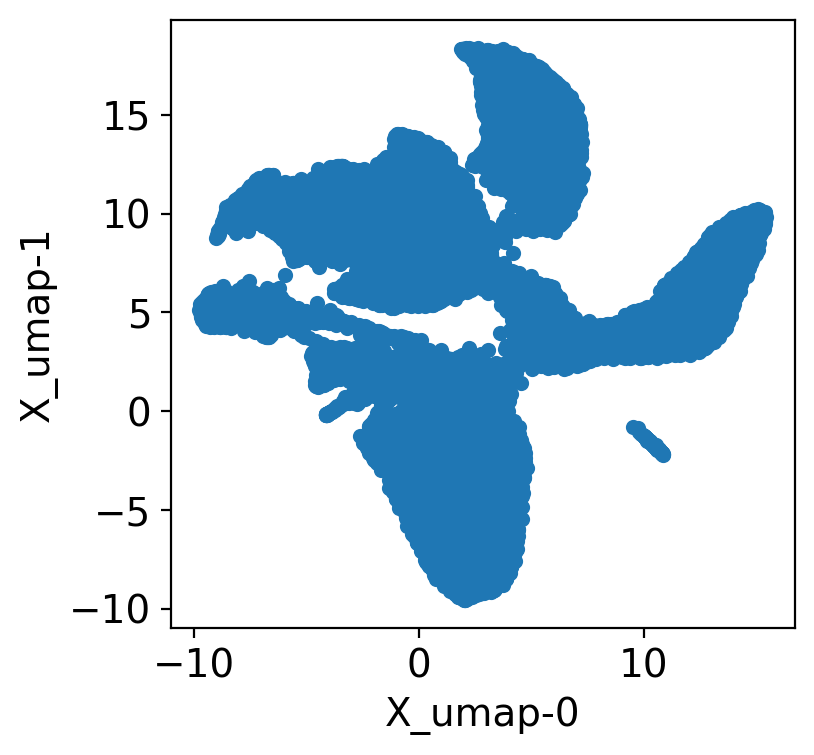

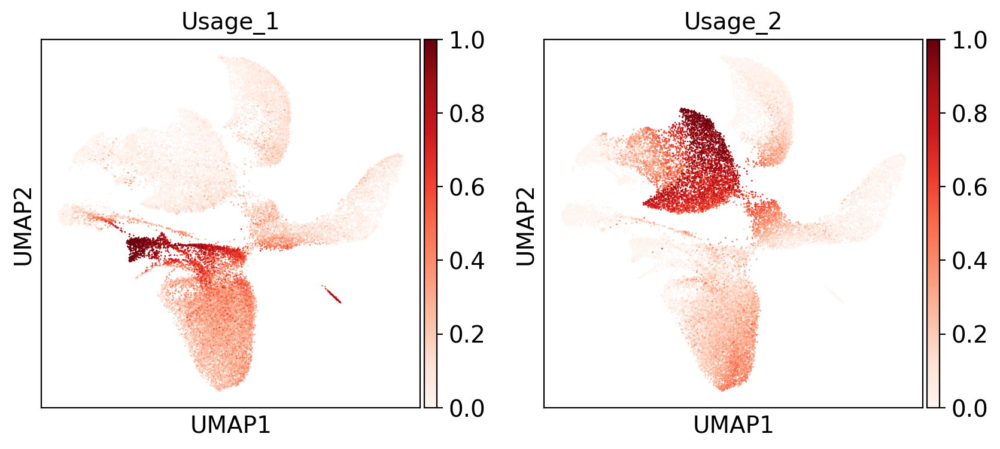

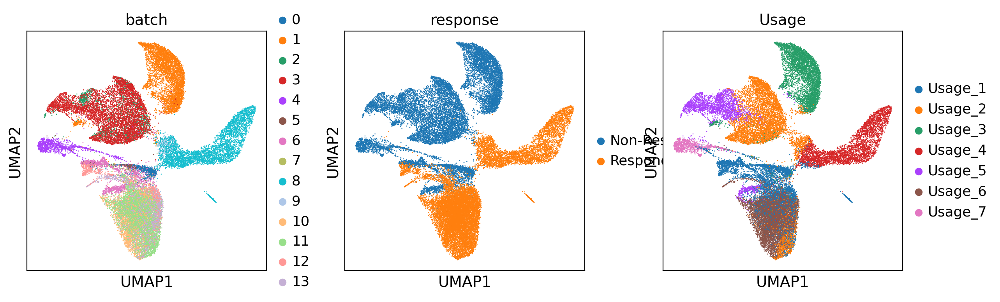

In [21]:

plotdf = sc.get.obs_df(
    adata,
    keys=["Usage", "n_genes","response"],
    obsm_keys=[("X_umap", 0), ("X_umap", 1)]
)

plotdf.columns


plotdf.plot.scatter("X_umap-0", "X_umap-1")#, c="CD44")  

sc.pl.umap(adata, color=['Usage_1','Usage_2'],
           use_raw=True, ncols=3, vmin=0, vmax=1)
sc.pl.umap(adata, color = ['batch', 'response','Usage'])#, save="cNMF_batch")

In [22]:
adata = sc.pp.log1p(adata.copy(), copy=True)



In [23]:
plotdf

,Usage,n_genes,response,X_umap-0,X_umap-1
GACCTGCAGCCACATG-1-0,Usage_1,8854,Non-Responder,2.674785,1.983171
GCTTACCTCTTGACCC-1-0,Usage_1,7847,Non-Responder,2.637859,1.995018
AGGTATTGTAGTTGGC-1-0,Usage_1,6287,Non-Responder,3.152928,1.121663
CAACTAATCGCTAGTG-1-0,Usage_1,6754,Non-Responder,1.569780,1.929827
GTTACGCCAAATGCCC-1-0,Usage_1,6182,Non-Responder,2.117440,2.433784
...,...,...,...,...,...
GCTTAACAGAGGCTAA-1-13,Usage_6,204,Responder,1.984699,-2.008764
ACCTGTTGTACGATTG-1-13,Usage_1,224,Responder,-1.871732,1.147735
GGTTGGTGTCAACAAT-1-13,Usage_1,210,Responder,3.260756,-3.001302
TGAAGGATCGGGACTC-1-13,Usage_6,217,Responder,4.366323,-2.272059


In [95]:
NR_cd44 = plotdf.loc[plotdf['response'] == 'Non-Responder'].CD44

In [96]:
R_cd44 = plotdf.loc[plotdf['response'] == 'Responder'].CD44

[Text(1, 0, 'NR_cd44'), Text(2, 0, 'R_cd44')]

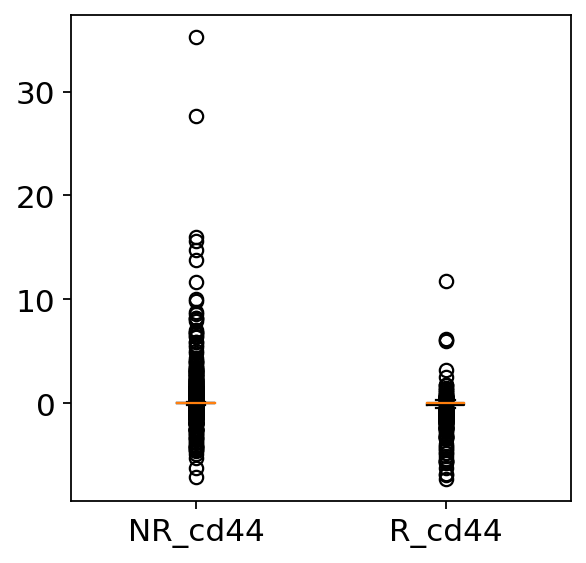

In [97]:
my_dict = {'NR_cd44': NR_cd44, 'R_cd44': R_cd44}

fig, ax = plt.subplots()
ax.boxplot(my_dict.values())
ax.set_xticklabels(my_dict.keys())

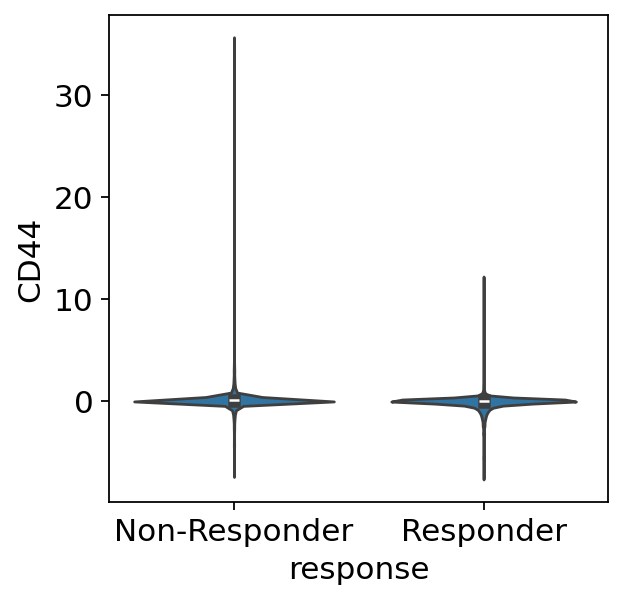

In [98]:
import seaborn as sns
ax = sns.violinplot(x='response',y='CD44', data=plotdf)




In [99]:
import numpy as np
from scipy.stats import ranksums
from scipy import stats

ranksums(NR_cd44, R_cd44)

RanksumsResult(statistic=12.686088713155717, pvalue=7.0625609305332045e-37)

In [108]:
from scipy.stats import mannwhitneyu
#mannwhitneyu(NR_cd44, R_cd44)

import scikit_posthocs as sp
sp.posthoc_mannwhitney([NR_cd44, R_cd44], p_adjust = 'bonferroni')

,1,2
1,1.000000e+00,7.063209e-37
2,7.063209e-37,1.000000e+00


In [105]:
sp.posthoc_ttest(plotdf, val_col='CD44', group_col='response', p_adjust='holm')

,Non-Responder,Responder
Non-Responder,1.000000e+00,1.772400e-19
Responder,1.772400e-19,1.000000e+00


In [106]:
sp.posthoc_ttest(plotdf, val_col='CD44', group_col='response', p_adjust='bonferroni')

,Non-Responder,Responder
Non-Responder,1.000000e+00,1.772400e-19
Responder,1.772400e-19,1.000000e+00


In [101]:
mannwhitneyu([-9,-3,10], [1,1,3])

MannwhitneyuResult(statistic=3.0, pvalue=0.6579050194284821)

In [52]:
top15['2']

1         DDX60L
2          MUC16
3           EMP1
4          ANXA1
5          MYEOV
6           SUN1
7        SLC20A1
8     AF117829.1
9       SERPINB1
10         NEAT1
11          SAT1
12        FNDC3B
13         LAMC2
14         GPR78
Name: 2, dtype: object

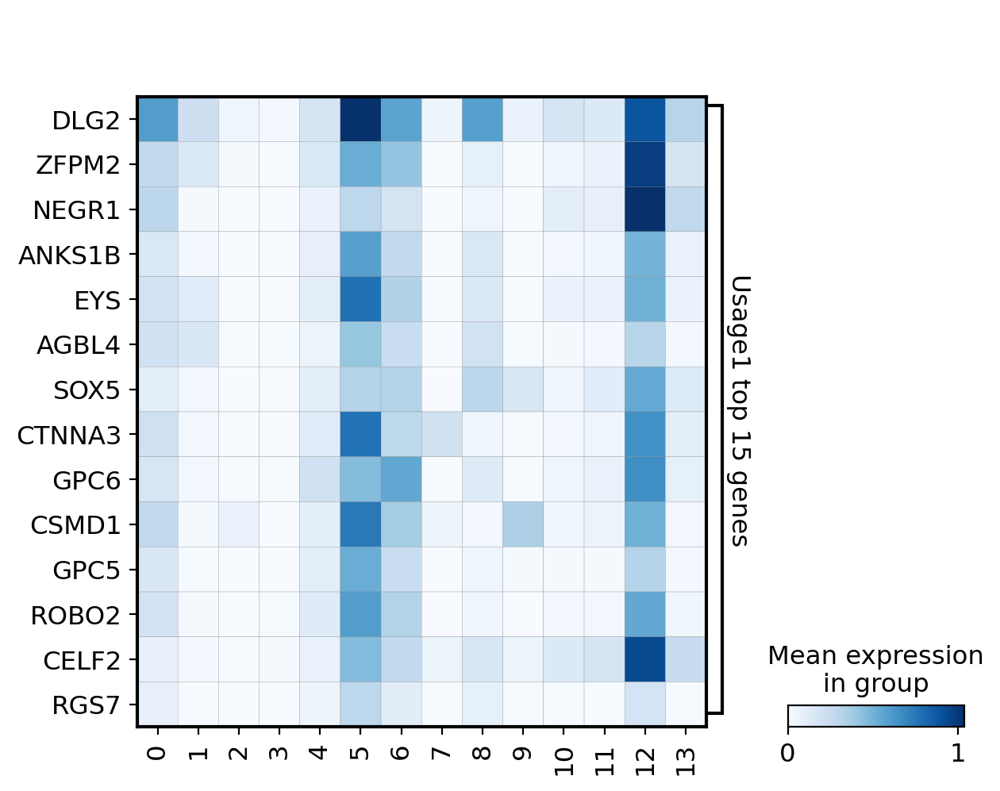

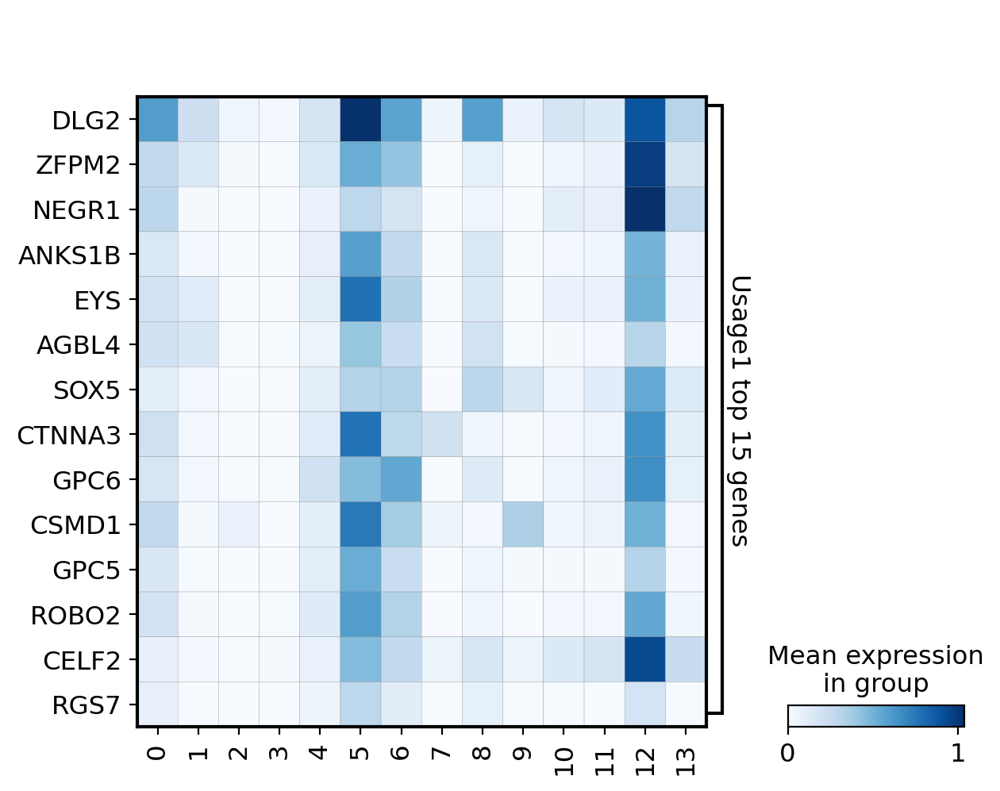

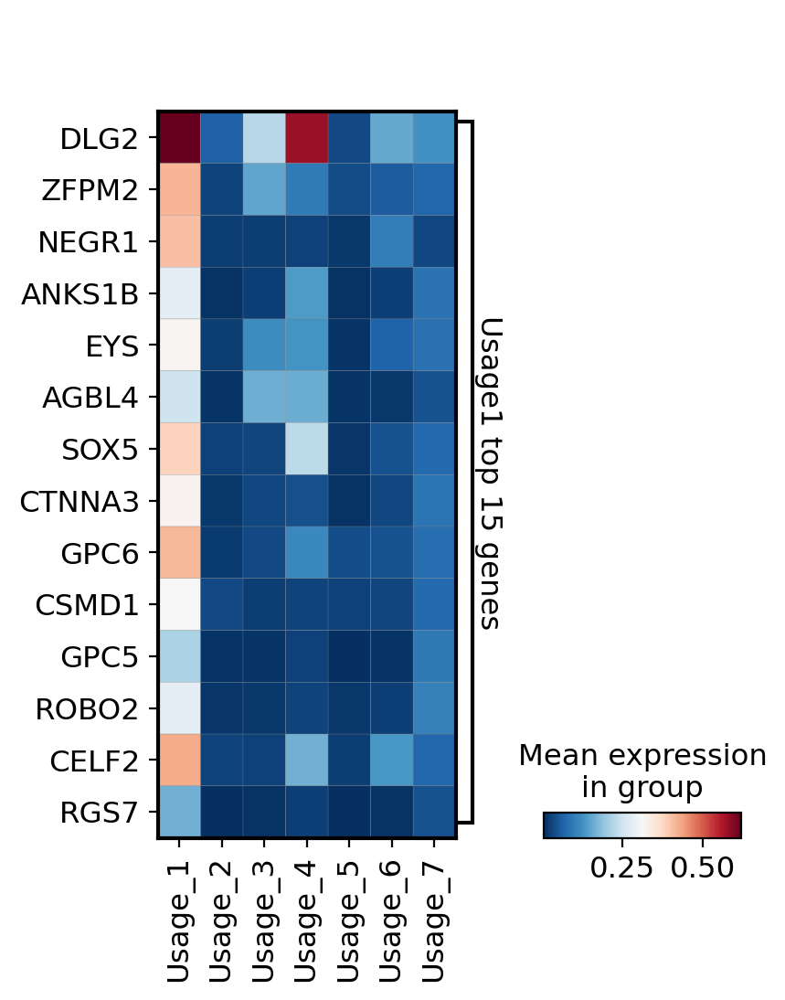

In [76]:

markers1 = {'Usage1 top 15 genes':['DLG2','ZFPM2','NEGR1','ANKS1B'   ,  'EYS',
   'AGBL4',
    'SOX5',
  'CTNNA3',
      'GPC6',
     'CSMD1',
      'GPC5',
     'ROBO2',
     'CELF2',
      'RGS7']}

sc.pl.matrixplot(adata, markers1, groupby='batch', dendrogram=False,swap_axes=True,cmap='Blues' )
sc.pl.matrixplot(adata, markers1, groupby='batch', dendrogram=False,swap_axes=True,cmap='Blues',vmin=None, vmax=None)
sc.pl.matrixplot(adata, markers1, groupby='Usage', dendrogram=False,swap_axes=True,cmap='RdBu_r')


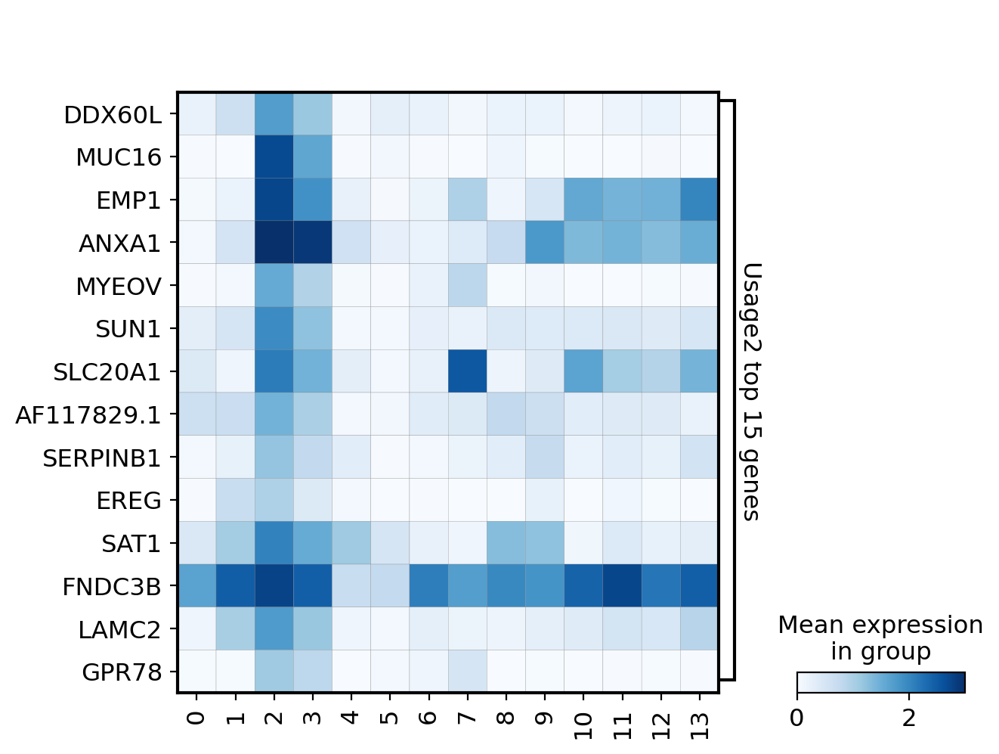

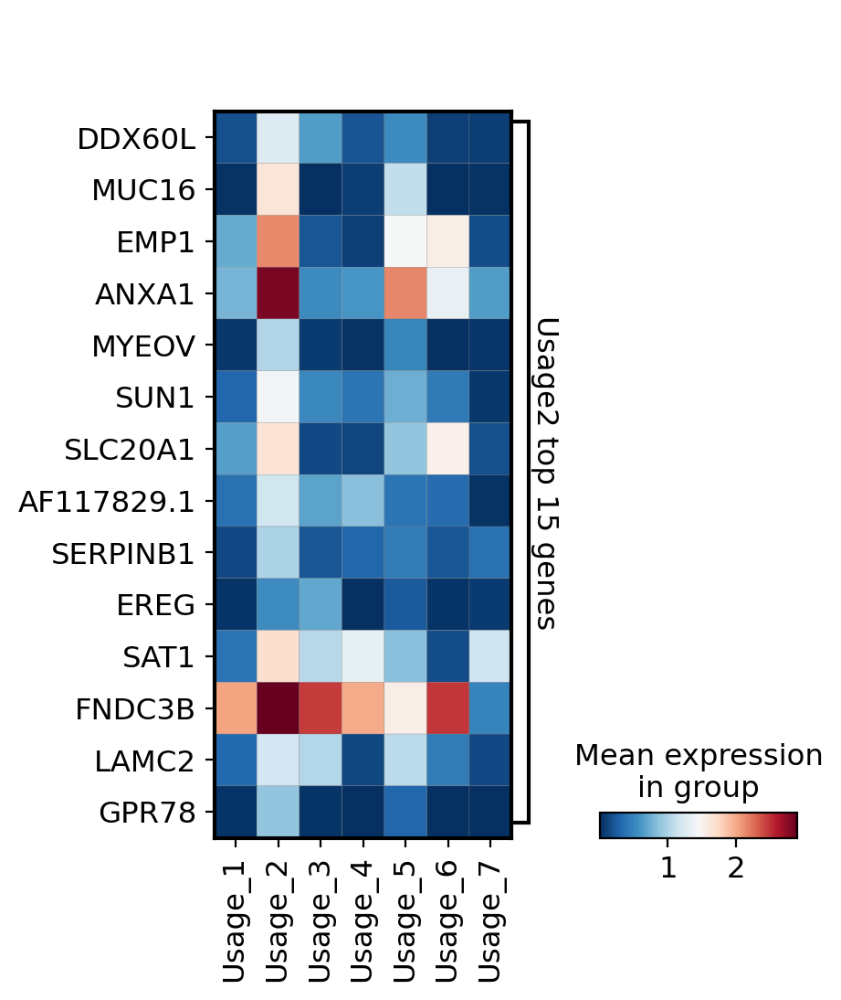

In [78]:

markers2 = {'Usage2 top 15 genes':[
            'DDX60L',
          'MUC16',
           'EMP1',
          'ANXA1',
          'MYEOV',
           'SUN1',
        'SLC20A1',
     'AF117829.1',
       'SERPINB1',
#         'NEAT1',
    'EREG',
          'SAT1',
        'FNDC3B',
         'LAMC2',
         'GPR78']}


sc.pl.matrixplot(adata, markers2, groupby='batch', dendrogram=False,swap_axes=True,cmap='Blues')
sc.pl.matrixplot(adata, markers2, groupby='Usage', dendrogram=False,swap_axes=True,cmap='RdBu_r')


In [89]:
markers = {
    'Usage1':['DLG2','ZFPM2','NEGR1','ANKS1B'   ,  'EYS',
   'AGBL4',
    'SOX5',
  'CTNNA3',
      'GPC6',
     'CSMD1',
      'GPC5',
     'ROBO2',
     'CELF2',
      'RGS7'],
    
    'Usage2':[
            'DDX60L',
          'MUC16',
           'EMP1',
          'ANXA1',
          'MYEOV',
           'SUN1',
        'SLC20A1',
     'AF117829.1',
       'SERPINB1',
#         'NEAT1',
    'EREG',
          'SAT1',
        'FNDC3B',
         'LAMC2',
         'GPR78'],
    
    'Usage3':['LINC01239',
     'LINC02241',
         'PCDH9',
          'TLL1',
          'EGFR',
      'MIR205HG',
          'TP63',
           'HGF',
      'NIPSNAP2',
        'UNC5C',
        'VOPP1',
      'LDLRAD3',
        'CDH13',
        'DIP2B'
    ],
    
    'Usage4':[
       'ARHGEF38',
           'TTC6',
        'SLC26A4',
         'SFMBT2',
           'ANKH',
           'XBP1',
     'CSGALNACT1',
        'LDLRAD4',
          'ESRRG',
      'KIAA1324',
        'GALNT7',
         'PDE8B',
         'CPNE4',
           'CPE'],
    'Usage5':[
       'RPL8',
     'TMSB4X',
       'LY6E',
       'RPS3',
       'RPS2',
        'B2M',
      'RPL10',
      'HLA-B',
     'IFITM3',
      'PTMA',
     'HLA-A',
     'RPL13',
     'RPL7A',
     'RPS19'
],
    'Usage6':[
         'MYL9',
         'TPM2',
        'TAGLN',
         'CNN1',
     'PPP1R14A',
         'PCP4',
        'ACTA2',
         'FLNC',
        'RAMP1',
        'FHL1',
      'IGFBP7',
        'SMTN',
       'CSRP1',
         'CLU'
],
    
    
    'Usage7':[
         'C1QA',
         'C1QB',
      'HLA-DRA',
        'TIMP1',
         'CTSB',
          'VIM',
     'HLA-DRB1',
          'FN1',
         'CD74',
        'MT2A',
       'GAPDH',
      'LGALS1',
         'FTL',
       'TGFBI'
]
    
    
    
    
}

In [86]:
markers3 = {'Usage3 top 15 genes':[
     'LINC01239',
     'LINC02241',
         'PCDH9',
          'TLL1',
          'EGFR',
      'MIR205HG',
          'TP63',
           'HGF',
      'NIPSNAP2',
        'UNC5C',
        'VOPP1',
      'LDLRAD3',
        'CDH13',
        'DIP2B']}

markers4 = {'Usage4 top 15 genes':[
       'ARHGEF38',
           'TTC6',
        'SLC26A4',
         'SFMBT2',
           'ANKH',
           'XBP1',
     'CSGALNACT1',
        'LDLRAD4',
          'ESRRG',
      'KIAA1324',
        'GALNT7',
         'PDE8B',
         'CPNE4',
           'CPE']}


markers5 = {'Usage5 top 15 genes':[
       'RPL8',
     'TMSB4X',
       'LY6E',
       'RPS3',
       'RPS2',
        'B2M',
      'RPL10',
      'HLA-B',
     'IFITM3',
      'PTMA',
     'HLA-A',
     'RPL13',
     'RPL7A',
     'RPS19'
]}

markers6 = {'Usage6 top 15 genes':[
         'MYL9',
         'TPM2',
        'TAGLN',
         'CNN1',
     'PPP1R14A',
         'PCP4',
        'ACTA2',
         'FLNC',
        'RAMP1',
        'FHL1',
      'IGFBP7',
        'SMTN',
       'CSRP1',
         'CLU'
]}

markers7 = {'Usage7 top 15 genes':[
         'C1QA',
         'C1QB',
      'HLA-DRA',
        'TIMP1',
         'CTSB',
          'VIM',
     'HLA-DRB1',
          'FN1',
         'CD74',
        'MT2A',
       'GAPDH',
      'LGALS1',
         'FTL',
       'TGFBI'
]}



In [1]:
sc.pl.matrixplot(adata, markers1, groupby='batch', dendrogram=False,swap_axes=True,cmap='Blues')
sc.pl.matrixplot(adata, markers2, groupby='batch', dendrogram=False,swap_axes=True,cmap='Blues')
sc.pl.matrixplot(adata, markers3, groupby='batch', dendrogram=False,swap_axes=True,cmap='Blues')
sc.pl.matrixplot(adata, markers4, groupby='batch', dendrogram=False,swap_axes=True,cmap='Blues')
sc.pl.matrixplot(adata, markers5, groupby='batch', dendrogram=False,swap_axes=True,cmap='Blues')
sc.pl.matrixplot(adata, markers6, groupby='batch', dendrogram=False,swap_axes=True,cmap='Blues')
sc.pl.matrixplot(adata, markers7, groupby='batch', dendrogram=False,swap_axes=True,cmap='Blues')


NameError: name 'sc' is not defined

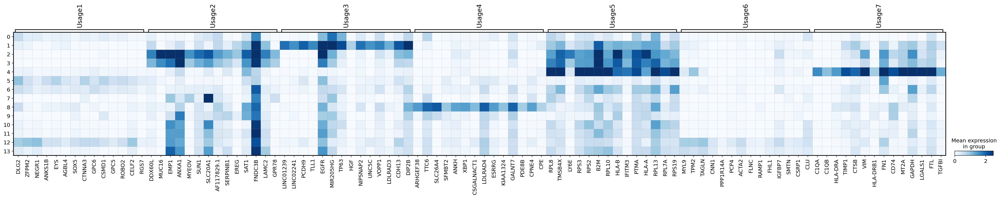

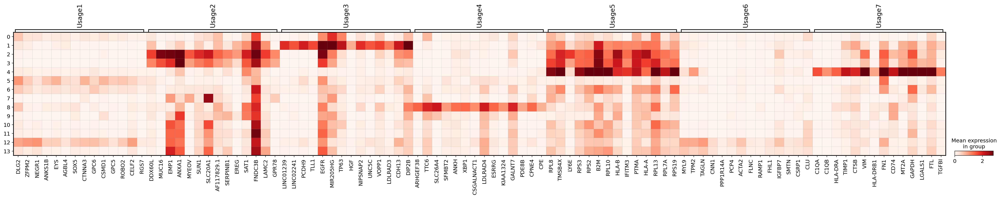

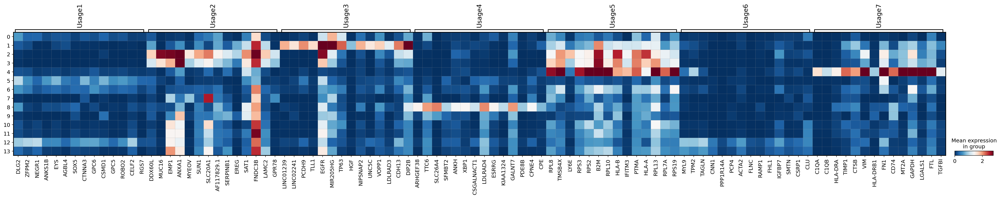

In [106]:
sc.pl.matrixplot(adata, markers, groupby='batch', dendrogram=False,swap_axes=False,cmap='Blues', vmax=2.5)
sc.pl.matrixplot(adata, markers, groupby='batch', dendrogram=False,swap_axes=False,cmap='Reds', vmax=2.8 )
sc.pl.matrixplot(adata, markers, groupby='batch', dendrogram=False,swap_axes=False,cmap='RdBu_r', vmax=2.8 )


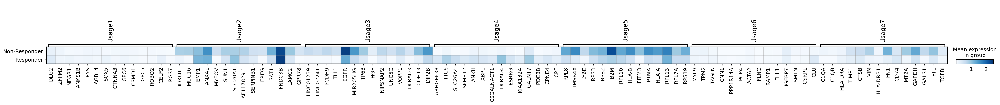

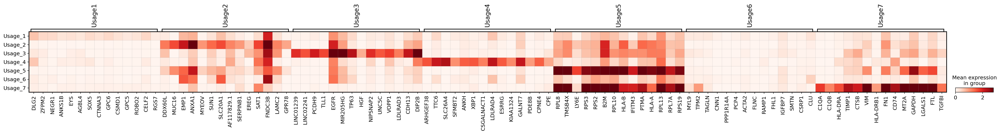

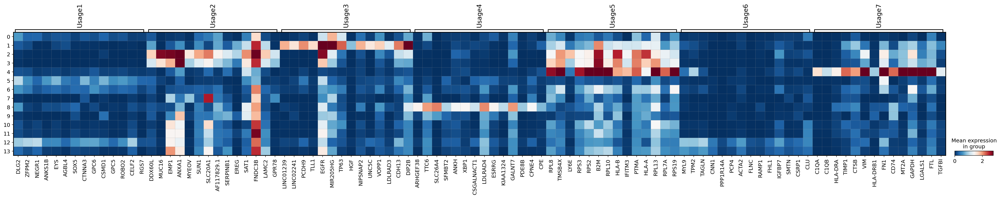

In [107]:
sc.pl.matrixplot(adata, markers, groupby='response', dendrogram=False,swap_axes=False,cmap='Blues', vmax=2.5)
sc.pl.matrixplot(adata, markers, groupby='Usage', dendrogram=False,swap_axes=False,cmap='Reds', vmax=2.8 )
sc.pl.matrixplot(adata, markers, groupby='batch', dendrogram=False,swap_axes=False,cmap='RdBu_r', vmax=2.8 )


In [5]:
adata.obs

,doublet_score,predicted_doublet,n_genes,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,total_counts_mito,log1p_total_counts_mito,pct_counts_mito,...,batch,n_counts,Usage_1,Usage_2,Usage_3,Usage_4,Usage_5,Usage_6,Usage_7,response
GACCTGCAGCCACATG-1-0,0.286375,False,8854,9947,9.205127,50461.0,10.828976,1334.0,7.196687,2.643626,...,0,45654.0,0.583531,0.060630,0.181815,0.092860,0.040639,0.000000,0.040524,Non-Responder
GCTTACCTCTTGACCC-1-0,0.294673,False,7847,8651,9.065546,37051.0,10.520078,934.0,6.840547,2.520849,...,0,33304.0,0.634282,0.078768,0.148861,0.071451,0.027413,0.022825,0.016400,Non-Responder
AGGTATTGTAGTTGGC-1-0,0.256236,False,6287,6686,8.807921,24483.0,10.105775,448.0,6.107023,1.829841,...,0,22591.0,0.444710,0.115435,0.128665,0.165192,0.126532,0.000049,0.019418,Non-Responder
CAACTAATCGCTAGTG-1-0,0.341772,False,6754,7406,8.910181,21485.0,9.975157,766.0,6.642487,3.565278,...,0,19063.0,0.710238,0.043686,0.105071,0.051342,0.040721,0.020234,0.028708,Non-Responder
GTTACGCCAAATGCCC-1-0,0.341772,False,6182,6817,8.827321,20956.0,9.950228,543.0,6.298949,2.591143,...,0,18433.0,0.706026,0.016839,0.201577,0.048736,0.024469,0.000000,0.002353,Non-Responder
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GCTTAACAGAGGCTAA-1-13,0.158111,False,204,220,5.398163,278.0,5.631212,9.0,2.302585,3.237410,...,13,235.0,0.286261,0.273423,0.003181,0.061121,0.000000,0.376014,0.000000,Responder
ACCTGTTGTACGATTG-1-13,0.332840,False,224,235,5.463832,261.0,5.568345,2.0,1.098612,0.766284,...,13,239.0,0.521627,0.000000,0.015803,0.098654,0.103811,0.236057,0.024047,Responder
GGTTGGTGTCAACAAT-1-13,0.132545,False,210,227,5.429346,247.0,5.513429,1.0,0.693147,0.404858,...,13,225.0,0.516353,0.059316,0.000000,0.076922,0.038327,0.309084,0.000000,Responder
TGAAGGATCGGGACTC-1-13,0.040681,False,217,234,5.459586,266.0,5.587249,2.0,1.098612,0.751880,...,13,238.0,0.077785,0.056757,0.324110,0.145788,0.000000,0.395561,0.000000,Responder


In [6]:
adata

AnnData object with n_obs × n_vars = 30333 × 2000
    obs: 'doublet_score', 'predicted_doublet', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_mt', 'pct_counts_mt', 'platelet', 'RBC', 'batch', 'n_counts', 'Usage_1', 'Usage_2', 'Usage_3', 'Usage_4', 'Usage_5', 'Usage_6', 'Usage_7', 'response'
    var: 'mt', 'ribo', 'n_cells', 'mean', 'std'
    uns: 'batch_colors', 'cluster_colors', 'neighbors', 'pca', 'response_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [8]:
gep_scores = pd.read_csv("gep_scores_cnmf_UrothelialONLY_nonharmonized.csv",index_col=0 ) 
gep_scores

,1,2,3,4,5,6,7
AL627309.5,0.000072,-0.000027,0.000051,-0.000041,-0.000068,-0.000008,1.013771e-05
LINC01409,0.000012,-0.000022,0.000053,0.000062,-0.000111,-0.000006,-2.809800e-05
LINC01128,0.000005,-0.000030,0.000105,0.000128,-0.000067,0.000008,-7.269289e-07
LINC00115,-0.000006,0.000140,0.000032,-0.000020,-0.000077,-0.000009,5.949245e-05
FAM41C,0.000010,-0.000032,0.000060,0.000005,0.000003,0.000026,1.340483e-05
...,...,...,...,...,...,...,...
TTTY14,-0.000164,-0.000110,-0.000132,0.000601,-0.000463,0.000005,-2.000050e-04
TTTY10,-0.000040,-0.000287,0.000854,0.000174,-0.000295,-0.000009,-9.264862e-05
AL354822.1,0.000021,-0.000022,0.000014,0.000069,-0.000064,0.000004,-1.616339e-05
AL592183.1,0.000110,-0.000101,-0.000265,0.000288,-0.000093,0.000012,-1.115544e-05


top_genes --> Survival analysis using HM+GREEK cohort




In [54]:
# top gene 
#!gsutil cp $bucket/cellranger_output_directory/bladder/cnmf/top_program_genes_cnmf_UrothelialONLY_nonharmonized.csv .
top_genes = pd.read_csv("top_program_genes_cnmf_UrothelialONLY_nonharmonized.csv",index_col=0 ) 
top15= top_genes[0:15]
top_genes[0:16]

,1,2,3,4,5,6,7
1,DLG2,DDX60L,LINC01239,ARHGEF38,RPL8,MYL9,C1QA
2,ZFPM2,MUC16,LINC02241,TTC6,TMSB4X,TPM2,C1QB
3,NEGR1,EMP1,PCDH9,SLC26A4,LY6E,TAGLN,HLA-DRA
4,ANKS1B,ANXA1,TLL1,SFMBT2,RPS3,CNN1,TIMP1
5,EYS,MYEOV,EGFR,ANKH,RPS2,PPP1R14A,CTSB
6,AGBL4,SUN1,MIR205HG,XBP1,B2M,PCP4,VIM
7,SOX5,SLC20A1,TP63,CSGALNACT1,RPL10,ACTA2,HLA-DRB1
8,CTNNA3,AF117829.1,HGF,LDLRAD4,HLA-B,FLNC,FN1
9,GPC6,SERPINB1,NIPSNAP2,ESRRG,IFITM3,RAMP1,CD74
10,CSMD1,NEAT1,UNC5C,KIAA1324,PTMA,FHL1,MT2A


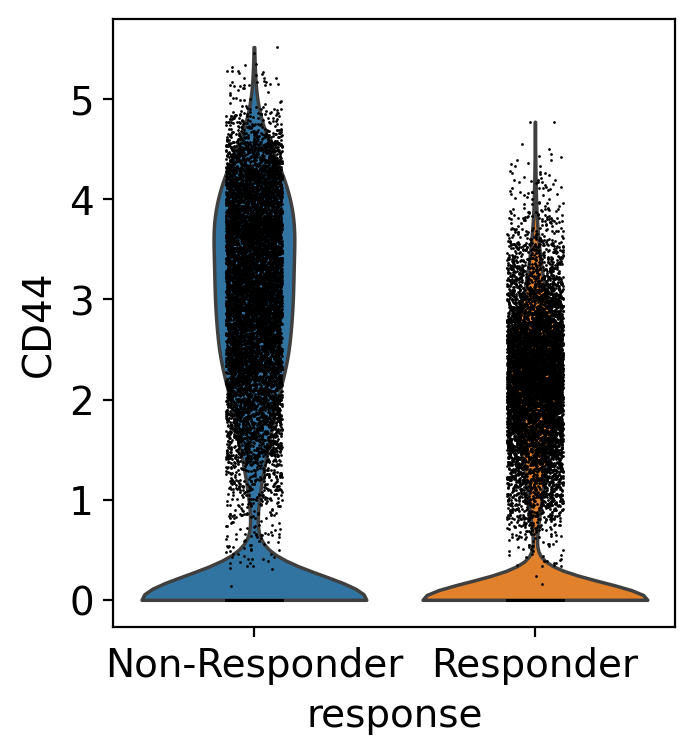

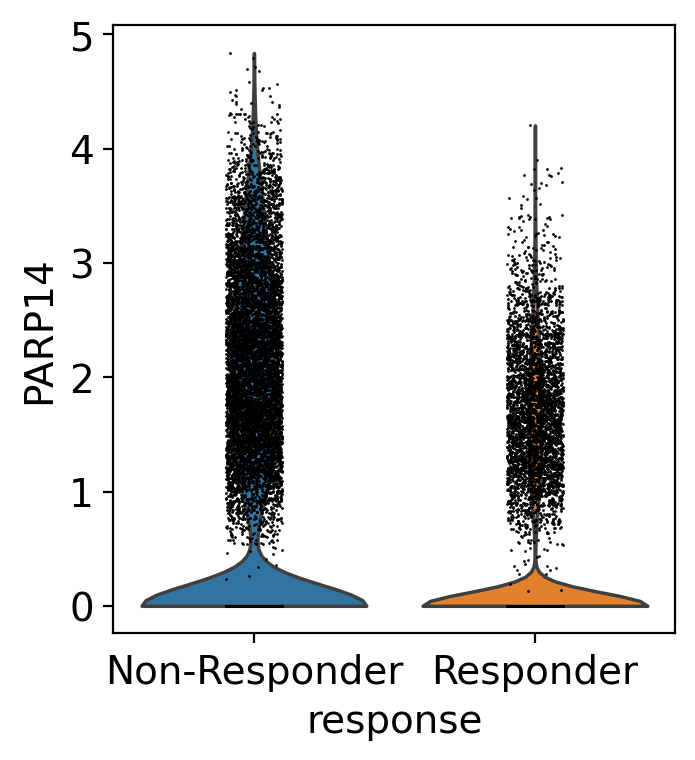

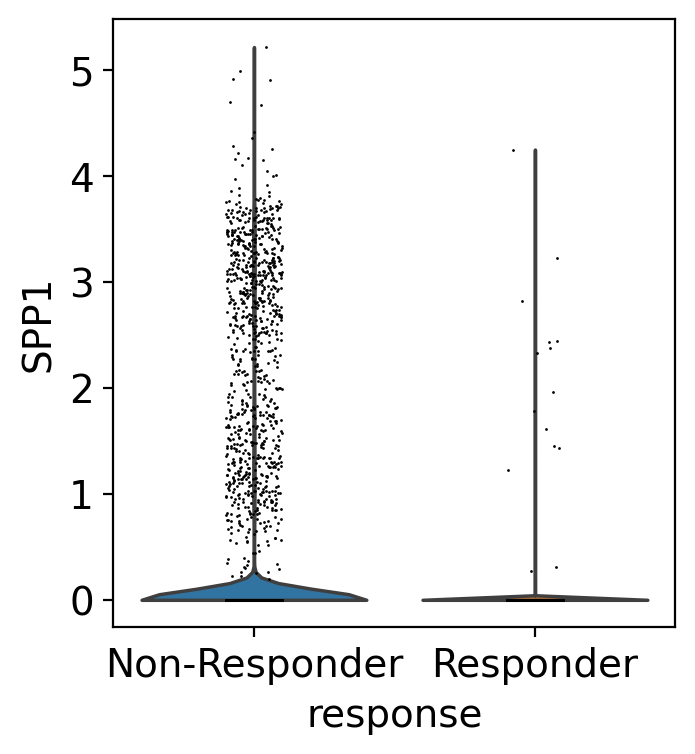

In [9]:
sc.pl.violin(adata, 'CD44', groupby= 'response', log=False, use_raw=None, stripplot=True, jitter=True, size=1, layer=None, scale='width', order=None, multi_panel=None, xlabel='', ylabel=None, rotation=None, show=None, save=None, ax=None)
sc.pl.violin(adata, 'PARP14', groupby= 'response', log=False, use_raw=None, stripplot=True, jitter=True, size=1, layer=None, scale='width', order=None, multi_panel=None, xlabel='', ylabel=None, rotation=None, show=None, save=None, ax=None)
sc.pl.violin(adata, 'SPP1', groupby= 'response', log=False, use_raw=None, stripplot=True, jitter=True, size=1, layer=None, scale='width', order=None, multi_panel=None, xlabel='', ylabel=None, rotation=None, show=None, save=None, ax=None)


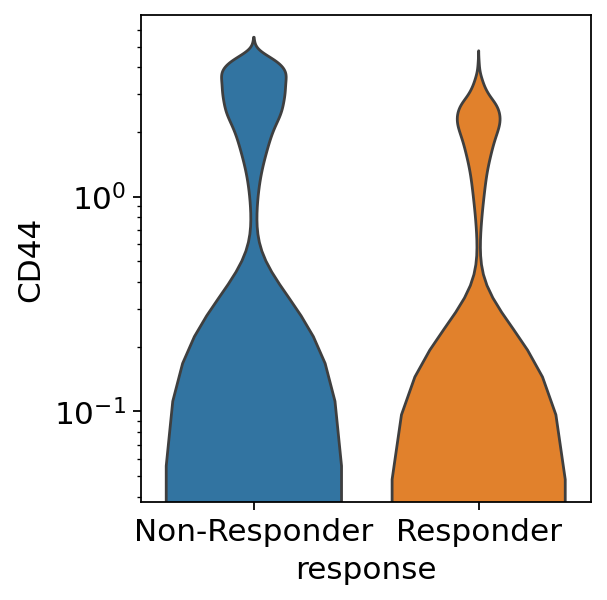

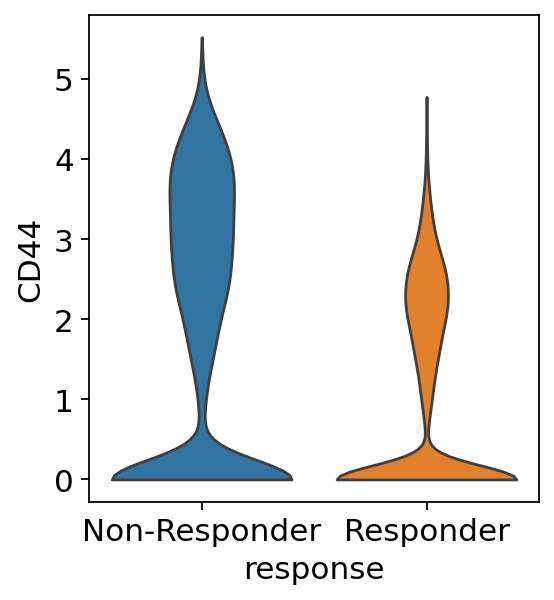

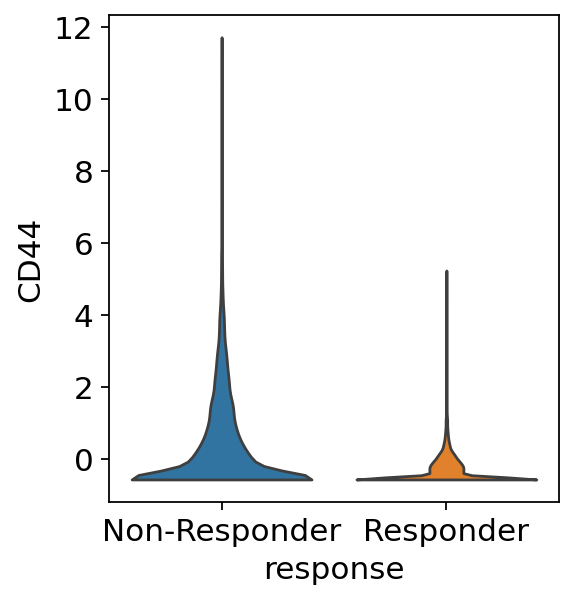

In [88]:
%matplotlib inline
from matplotlib import pyplot as plt
plt.rcParams["axes.grid"] = False
sc.pl.violin(adata, 'CD44', groupby= 'response', log=True, use_raw=None, stripplot=False, jitter=True, size=1, layer=None, scale='width', order=None, multi_panel=None, xlabel='', ylabel=None, rotation=None, show=None, save=None, ax=None)
sc.pl.violin(adata, 'CD44', groupby= 'response', log=False, use_raw=True, stripplot=False, jitter=True, size=1, layer=None, scale='width', order=None, multi_panel=None, xlabel='', ylabel=None, rotation=None, show=None, save=None, ax=None)
sc.pl.violin(adata, 'CD44', groupby= 'response', log=False, use_raw=False, stripplot=False, jitter=True, size=1, layer=None, scale='width', order=None, multi_panel=None, xlabel='', ylabel=None, rotation=None, show=None, save=None, ax=None)



ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:43)


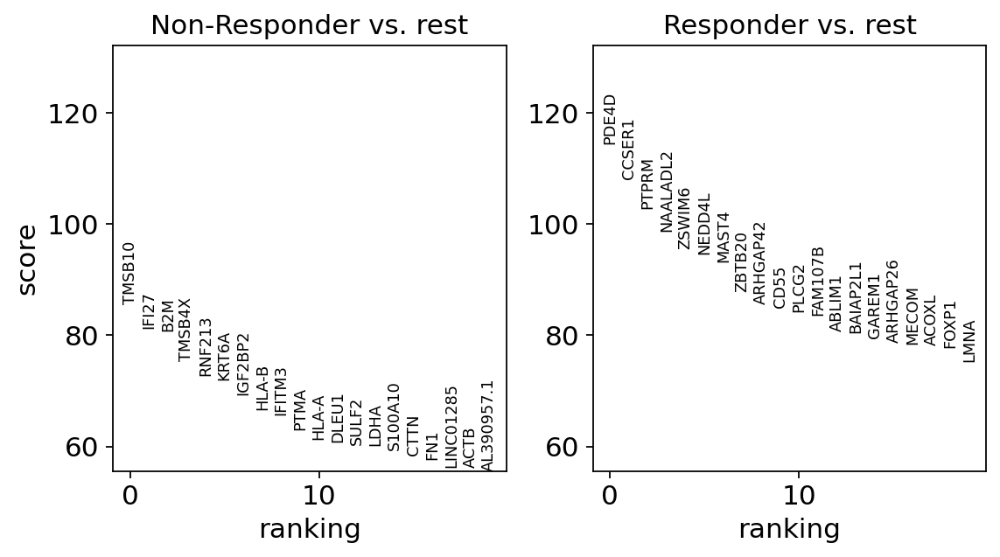

In [13]:
sc.tl.rank_genes_groups(adata, 'response', method='wilcoxon')
# to visualize the results
sc.pl.rank_genes_groups(adata)

In [20]:
adata.uns['rank_genes_groups']

{'params': {'groupby': 'response',
  'reference': 'rest',
  'method': 'wilcoxon',
  'use_raw': True,
  'layer': None,
  'corr_method': 'benjamini-hochberg'},
 'names': rec.array([('TMSB10', 'PDE4D'), ('IFI27', 'CCSER1'), ('B2M', 'PTPRM'),
            ..., ('PTPRM', 'B2M'), ('CCSER1', 'IFI27'),
            ('PDE4D', 'TMSB10')],
           dtype=[('Non-Responder', 'O'), ('Responder', 'O')]),
 'scores': rec.array([(  85.64181 , 114.48493 ), (  81.19416 , 108.047714),
            (  80.80018 , 102.748665), ..., (-102.748665, -80.80018 ),
            (-108.047714, -81.19416 ), (-114.48493 , -85.64181 )],
           dtype=[('Non-Responder', '<f4'), ('Responder', '<f4')]),
 'pvals': rec.array([(0., 0.), (0., 0.), (0., 0.), ..., (0., 0.), (0., 0.),
            (0., 0.)],
           dtype=[('Non-Responder', '<f8'), ('Responder', '<f8')]),
 'pvals_adj': rec.array([(0., 0.), (0., 0.), (0., 0.), ..., (0., 0.), (0., 0.),
            (0., 0.)],
           dtype=[('Non-Responder', '<f8'), ('Responder

In [23]:
dedf = sc.get.rank_genes_groups_df(adata, group="Non-Responder")

In [24]:
dedf

,names,scores,logfoldchanges,pvals,pvals_adj
0,TMSB10,85.641808,4.274212,0.0,0.0
1,IFI27,81.194160,7.861488,0.0,0.0
2,B2M,80.800179,2.647571,0.0,0.0
3,TMSB4X,75.427444,3.464604,0.0,0.0
4,RNF213,72.701866,2.668078,0.0,0.0
...,...,...,...,...,...
14555,ZSWIM6,-95.469017,-2.970435,0.0,0.0
14556,NAALADL2,-98.658096,-3.164229,0.0,0.0
14557,PTPRM,-102.748665,-3.783767,0.0,0.0
14558,CCSER1,-108.047714,-4.006760,0.0,0.0


In [25]:
dedf.loc[dedf['names'] == 'CD44']

,names,scores,logfoldchanges,pvals,pvals_adj
49,CD44,43.973038,1.562449,0.0,0.0


In [26]:
df = sc.get.rank_genes_groups_df(adata, group="Responder")

In [89]:
df.loc[df['names'] == 'CD44']

,names,scores,logfoldchanges,pvals,pvals_adj
14510,CD44,-43.973038,-1.562449,0.0,0.0


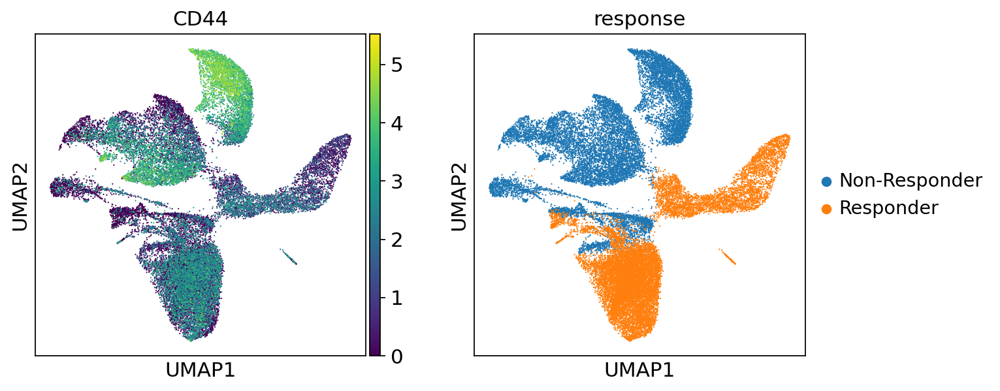

In [90]:
sc.pl.umap(adata, color = ['CD44', 'response'])#, save="cNMF_batch")

In [91]:
adata.X

array([[-0.22005008, -0.03784195, -0.09174879, ..., -0.0429136 ,
        -0.03128833, -0.04565309],
       [-0.21082437, -0.03784195,  0.08755171, ..., -0.0429136 ,
        -0.03128833, -0.04565309],
       [-0.19465148, -0.03784195, -0.09174879, ..., -0.0429136 ,
        -0.03128833, -0.04565309],
       ...,
       [-0.2449289 , -0.03784195, -0.09174879, ..., -0.0429136 ,
        -0.03128833, -0.04565309],
       [-0.2449289 , -0.03784195, -0.09174879, ..., -0.0429136 ,
        -0.03128833, -0.04565309],
       [-0.2449289 , -0.03784195, -0.09174879, ..., -0.0429136 ,
        -0.03128833, -0.04565309]], dtype=float32)

In [93]:
adata.X

array([[-0.24852557, -0.03857655, -0.09623428, ..., -0.04386161,
        -0.03178826, -0.04672803],
       [-0.23676638, -0.03857655,  0.08392902, ..., -0.04386161,
        -0.03178826, -0.04672803],
       [-0.21648017, -0.03857655, -0.09623428, ..., -0.04386161,
        -0.03178826, -0.04672803],
       ...,
       [-0.28094336, -0.03857655, -0.09623428, ..., -0.04386161,
        -0.03178826, -0.04672803],
       [-0.28094336, -0.03857655, -0.09623428, ..., -0.04386161,
        -0.03178826, -0.04672803],
       [-0.28094336, -0.03857655, -0.09623428, ..., -0.04386161,
        -0.03178826, -0.04672803]], dtype=float32)

In [49]:
adata.obs

,doublet_score,predicted_doublet,n_genes,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,total_counts_mito,log1p_total_counts_mito,pct_counts_mito,...,batch,n_counts,Usage_1,Usage_2,Usage_3,Usage_4,Usage_5,Usage_6,Usage_7,response
GACCTGCAGCCACATG-1-0,0.286375,False,8854,9947,9.205127,50461.0,10.828976,1334.0,7.196687,2.643626,...,0,45654.0,0.583531,0.060630,0.181815,0.092860,0.040639,0.000000,0.040524,Non-Responder
GCTTACCTCTTGACCC-1-0,0.294673,False,7847,8651,9.065546,37051.0,10.520078,934.0,6.840547,2.520849,...,0,33304.0,0.634282,0.078768,0.148861,0.071451,0.027413,0.022825,0.016400,Non-Responder
AGGTATTGTAGTTGGC-1-0,0.256236,False,6287,6686,8.807921,24483.0,10.105775,448.0,6.107023,1.829841,...,0,22591.0,0.444710,0.115435,0.128665,0.165192,0.126532,0.000049,0.019418,Non-Responder
CAACTAATCGCTAGTG-1-0,0.341772,False,6754,7406,8.910181,21485.0,9.975157,766.0,6.642487,3.565278,...,0,19063.0,0.710238,0.043686,0.105071,0.051342,0.040721,0.020234,0.028708,Non-Responder
GTTACGCCAAATGCCC-1-0,0.341772,False,6182,6817,8.827321,20956.0,9.950228,543.0,6.298949,2.591143,...,0,18433.0,0.706026,0.016839,0.201577,0.048736,0.024469,0.000000,0.002353,Non-Responder
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GCTTAACAGAGGCTAA-1-13,0.158111,False,204,220,5.398163,278.0,5.631212,9.0,2.302585,3.237410,...,13,235.0,0.286261,0.273423,0.003181,0.061121,0.000000,0.376014,0.000000,Responder
ACCTGTTGTACGATTG-1-13,0.332840,False,224,235,5.463832,261.0,5.568345,2.0,1.098612,0.766284,...,13,239.0,0.521627,0.000000,0.015803,0.098654,0.103811,0.236057,0.024047,Responder
GGTTGGTGTCAACAAT-1-13,0.132545,False,210,227,5.429346,247.0,5.513429,1.0,0.693147,0.404858,...,13,225.0,0.516353,0.059316,0.000000,0.076922,0.038327,0.309084,0.000000,Responder
TGAAGGATCGGGACTC-1-13,0.040681,False,217,234,5.459586,266.0,5.587249,2.0,1.098612,0.751880,...,13,238.0,0.077785,0.056757,0.324110,0.145788,0.000000,0.395561,0.000000,Responder


<Axes: xlabel='X_umap-0', ylabel='X_umap-1'>

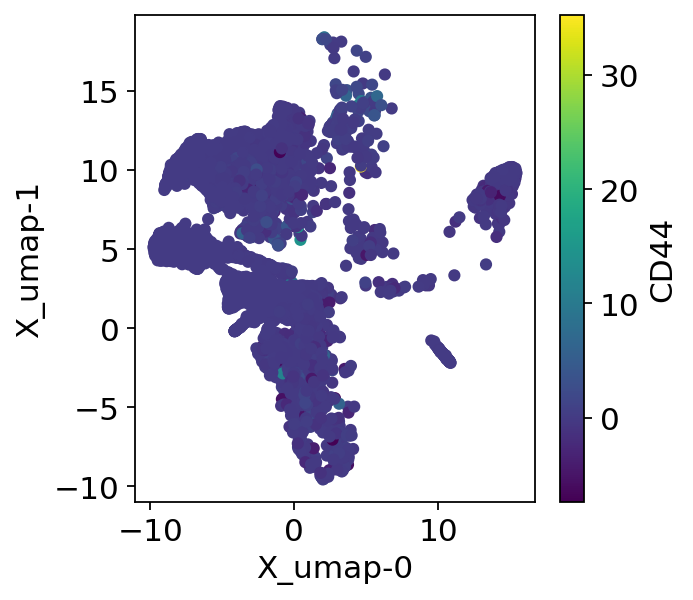

In [81]:

plotdf = sc.get.obs_df(
    adata,
    keys=["CD44", "n_genes","response"],
    obsm_keys=[("X_umap", 0), ("X_umap", 1)]
)

plotdf.columns


plotdf.plot.scatter("X_umap-0", "X_umap-1", c="CD44")  


In [92]:
adata = sc.pp.log1p(adata.copy(), copy=True)



In [94]:
plotdf

,CD44,n_genes,response,X_umap-0,X_umap-1
CAACTAATCGCTAGTG-1-0,-0.303921,6754,Non-Responder,1.569780,1.929827
CATAGGTTCCAAATCA-1-0,0.011648,3933,Non-Responder,-1.530044,1.444806
GTATCGCCATTGTCCT-1-0,-0.271050,3968,Non-Responder,1.183505,1.790638
CCACTTGGTTTCGCGC-1-0,-0.033362,3865,Non-Responder,0.255698,1.380347
ACTTTGTTCCTCATGC-1-0,-0.119068,3849,Non-Responder,1.054017,1.954876
...,...,...,...,...,...
TCCTTGCAGAGCAAGC-1-13,0.020533,221,Responder,-2.052587,1.325756
CCGCTAAAGCCTGGTA-1-13,0.024717,212,Responder,-2.650068,1.115999
GCTTAACAGAGGCTAA-1-13,-0.104809,204,Responder,1.984699,-2.008764
ACCTGTTGTACGATTG-1-13,0.009422,224,Responder,-1.871732,1.147735


In [95]:
NR_cd44 = plotdf.loc[plotdf['response'] == 'Non-Responder'].CD44

In [96]:
R_cd44 = plotdf.loc[plotdf['response'] == 'Responder'].CD44

[Text(1, 0, 'NR_cd44'), Text(2, 0, 'R_cd44')]

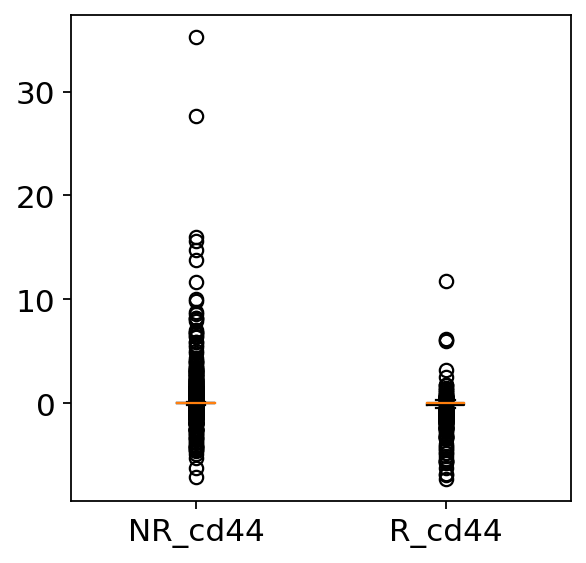

In [97]:
my_dict = {'NR_cd44': NR_cd44, 'R_cd44': R_cd44}

fig, ax = plt.subplots()
ax.boxplot(my_dict.values())
ax.set_xticklabels(my_dict.keys())

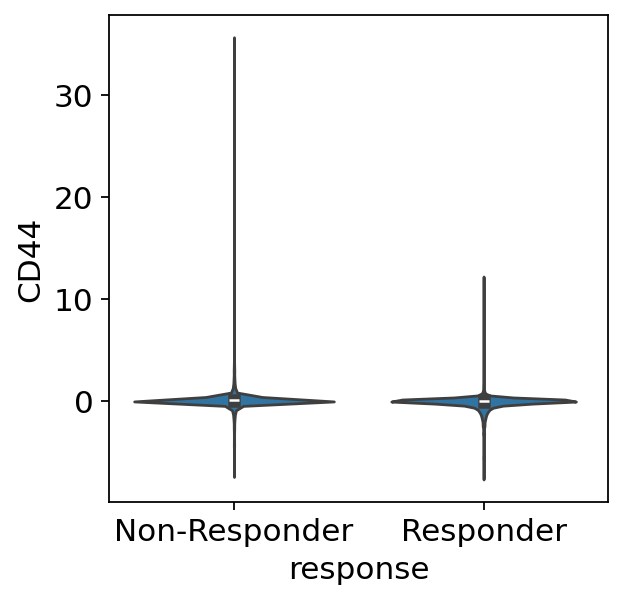

In [98]:
import seaborn as sns
ax = sns.violinplot(x='response',y='CD44', data=plotdf)




In [99]:
import numpy as np
from scipy.stats import ranksums
from scipy import stats

ranksums(NR_cd44, R_cd44)

RanksumsResult(statistic=12.686088713155717, pvalue=7.0625609305332045e-37)

In [108]:
from scipy.stats import mannwhitneyu
#mannwhitneyu(NR_cd44, R_cd44)

import scikit_posthocs as sp
sp.posthoc_mannwhitney([NR_cd44, R_cd44], p_adjust = 'bonferroni')

,1,2
1,1.000000e+00,7.063209e-37
2,7.063209e-37,1.000000e+00


In [105]:
sp.posthoc_ttest(plotdf, val_col='CD44', group_col='response', p_adjust='holm')

,Non-Responder,Responder
Non-Responder,1.000000e+00,1.772400e-19
Responder,1.772400e-19,1.000000e+00


In [106]:
sp.posthoc_ttest(plotdf, val_col='CD44', group_col='response', p_adjust='bonferroni')

,Non-Responder,Responder
Non-Responder,1.000000e+00,1.772400e-19
Responder,1.772400e-19,1.000000e+00


In [101]:
mannwhitneyu([-9,-3,10], [1,1,3])

MannwhitneyuResult(statistic=3.0, pvalue=0.6579050194284821)

Ranked lists of gene sets (MSigDB hallmark) (83) enriched in each program 

(Mann-Whitney U test, false discovery rate (FDR) < 5 × 10−4; *FDR < 10−6; **FDR < 10−12).



In [9]:
library(msigdbr)
library(fgsea)
library(dplyr)
library(ggplot2)

msigdbr_show_species()

NameError: name 'library' is not defined

In [10]:
m_df<- msigdbr(species = "Homo sapiens", category = "H")

#head(m_df)
fgsea_sets<- m_df %>% split(x = .$gene_symbol, f = .$gs_name)
fgsea_sets$HALLMARK_INTERFERON_ALPHA_RESPONSE

SyntaxError: invalid syntax (2572390547.py, line 4)

scanpy==1.9.3 anndata==0.8.0 numpy==1.21.6 scipy==1.7.3 pandas==1.3.5 scikit-learn==1.0.2 statsmodels==0.13.5 pynndescent==0.5.11

In [1]:
%matplotlib inline

import os
import time
import pandas as pd
import numpy as np
from scipy.io import mmread
import scipy.sparse as sp
import matplotlib.pyplot as plt
from IPython.display import Image
import scanpy as sc
import anndata as ad
from scipy.sparse import csr_matrix
import logging

from cnmf import cNMF

#from skbio.stats.composition import clr

import matplotlib.pyplot as plt
import matplotlib.axes as axes
#For CLR of ADTs
import scipy
import scipy.stats
from sklearn.preprocessing import scale

BILLING_PROJECT_ID = os.environ['WORKSPACE_NAMESPACE']
WORKSPACE = os.environ['WORKSPACE_NAME']
bucket = os.environ['WORKSPACE_BUCKET']

sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')

scanpy==1.9.3 anndata==0.8.0 numpy==1.21.6 scipy==1.7.3 pandas==1.3.5 scikit-learn==1.0.2 statsmodels==0.13.5 pynndescent==0.5.11


https://github.com/dylkot/cNMF/blob/master/Tutorials/analyze_pbmc_example_data.ipynb

In [4]:
#!gsutil cp $bucket/cellranger_output_directory/bladder/harmony/non_harmonized_urothelial_only_raw_for_cNMF.h5ad .
#!gsutil cp $bucket/cellranger_output_directory/bladder/BLAD1029/doublet_removed.h5ad .
adata = sc.read_h5ad("non_harmonized_urothelial_only_raw_for_cNMF.h5ad")


In [5]:
adata #only Urothelial subset

AnnData object with n_obs × n_vars = 30444 × 14574
    obs: 'doublet_score', 'predicted_doublet', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_mt', 'pct_counts_mt', 'platelet', 'RBC', 'batch'
    var: 'mt', 'ribo', 'n_cells'

In [6]:
sc.pp.filter_cells(adata, min_genes=200) # filter cells with fewer than 200 genes
sc.pp.filter_cells(adata, min_counts=200)  # This is a weaker threshold than above. It is just to population the n_counts column in adata
sc.pp.filter_genes(adata, min_cells=3) # filter genes detected in fewer than 3 cells


In [7]:
adata

AnnData object with n_obs × n_vars = 30444 × 14574
    obs: 'doublet_score', 'predicted_doublet', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_mt', 'pct_counts_mt', 'platelet', 'RBC', 'batch', 'n_counts'
    var: 'mt', 'ribo', 'n_cells'

In [8]:
##  remove mitochondrial genes and MALAT1 gene #As the level of expression of mitochondrial and MALAT1 genes are judged as mainly technical, it can be wise to remove them from the dataset bofore any further analysis.
malat1 = adata.var_names.str.startswith('MALAT1')
# we need to redefine the mito_genes since they were first 
# calculated on the full object before removing low expressed genes.
mito_genes = adata.var_names.str.startswith('MT-')

remove = np.add(mito_genes, malat1)
keep = np.invert(remove)

adata = adata[:,keep]

print(adata.n_obs, adata.n_vars)


30444 14560


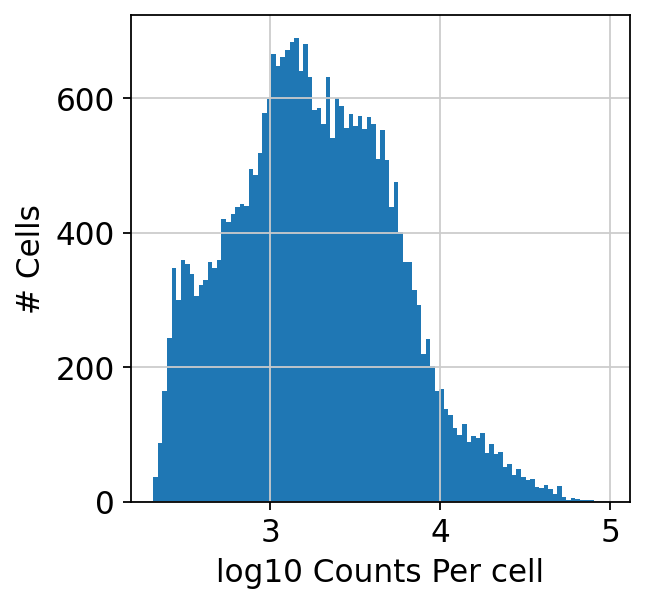

In [9]:
## plot log10 # counts per cell
plt.hist(np.log10(adata.obs['n_counts']), bins=100)
_ = plt.xlabel('log10 Counts Per cell')
_ = plt.ylabel('# Cells')

In [10]:
count_adat_fn = 'counts.h5ad'
sc.write(count_adat_fn, adata)

In [11]:
numiter=30 # Number of NMF replicates. Set this to a larger value ~200 for real data. We set this to a relatively low value here for illustration at a faster speed
numhvgenes=2000 ## Number of over-dispersed genes to use for running the actual factorizations

## Results will be saved to [output_directory]/[run_name] which in this example is example_PBMC/cNMF/pbmc_cNMF
output_directory = 'cNMF'
if not os.path.exists(output_directory):
    os.mkdir(output_directory)
run_name = 'uro_cNMF'

## Specify the Ks to use as a space separated list in this case "5 6 7 8 9 10"
K = ' '.join([str(i) for i in range(5,11)])

## To speed this up, you can run it for only K=7-8 with the option below
#K = ' '.join([str(i) for i in range(7,9)])


seed = 14 ## Specify a seed pseudorandom number generation for reproducibility

## Path to the filtered counts dataset we output previously
countfn = 'counts.h5ad'

In [12]:
## Initialize the cnmf object that will be used to run analyses
cnmf_obj = cNMF(output_dir=output_directory, name=run_name)

In [13]:
## Prepare the data, I.e. subset to 2000 high-variance genes, and variance normalize
cnmf_obj.prepare(counts_fn=countfn, components=np.arange(5,11), n_iter=30, seed=14, num_highvar_genes=2000)

normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


/home/jupyter/.local/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [14]:
## Specify that the jobs are being distributed over a single worker (total_workers=1) and then launch that worker
cnmf_obj.factorize(worker_i=0, total_workers=1)

[Worker 0]. Starting task 0.
[Worker 0]. Starting task 1.
[Worker 0]. Starting task 2.
[Worker 0]. Starting task 3.
[Worker 0]. Starting task 4.
[Worker 0]. Starting task 5.
[Worker 0]. Starting task 6.
[Worker 0]. Starting task 7.
[Worker 0]. Starting task 8.
[Worker 0]. Starting task 9.
[Worker 0]. Starting task 10.
[Worker 0]. Starting task 11.
[Worker 0]. Starting task 12.
[Worker 0]. Starting task 13.
[Worker 0]. Starting task 14.
[Worker 0]. Starting task 15.
[Worker 0]. Starting task 16.
[Worker 0]. Starting task 17.
[Worker 0]. Starting task 18.
[Worker 0]. Starting task 19.
[Worker 0]. Starting task 20.
[Worker 0]. Starting task 21.
[Worker 0]. Starting task 22.
[Worker 0]. Starting task 23.
[Worker 0]. Starting task 24.
[Worker 0]. Starting task 25.
[Worker 0]. Starting task 26.
[Worker 0]. Starting task 27.
[Worker 0]. Starting task 28.
[Worker 0]. Starting task 29.
[Worker 0]. Starting task 30.
[Worker 0]. Starting task 31.
[Worker 0]. Starting task 32.
[Worker 0]. Starting

In [15]:
cmd = 'cnmf prepare --output-dir cNMF --name uro_cNMF -c counts.h5ad -k 5 6 7 8 9 10 --n-iter 20 --total-workers 1 --seed 14 --numgenes 2000 --beta-loss frobenius'
print('Command line - prepare step: %s' % cmd)
!{cmd}

Command line - prepare step: cnmf prepare --output-dir cNMF --name uro_cNMF -c counts.h5ad -k 5 6 7 8 9 10 --n-iter 20 --total-workers 1 --seed 14 --numgenes 2000 --beta-loss frobenius
/home/jupyter/.local/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [16]:
cmd = 'cnmf factorize --output-dir cNMF --name uro_cNMF --worker-index 0'
print('Command line - factorize step: %s' % cmd)
!{cmd}

Command line - factorize step: cnmf factorize --output-dir cNMF --name uro_cNMF --worker-index 0
[Worker 0]. Starting task 0.
[Worker 0]. Starting task 1.
[Worker 0]. Starting task 2.
[Worker 0]. Starting task 3.
[Worker 0]. Starting task 4.
[Worker 0]. Starting task 5.
[Worker 0]. Starting task 6.
[Worker 0]. Starting task 7.
[Worker 0]. Starting task 8.
[Worker 0]. Starting task 9.
[Worker 0]. Starting task 10.
[Worker 0]. Starting task 11.
[Worker 0]. Starting task 12.
[Worker 0]. Starting task 13.
[Worker 0]. Starting task 14.
[Worker 0]. Starting task 15.
[Worker 0]. Starting task 16.
[Worker 0]. Starting task 17.
[Worker 0]. Starting task 18.
[Worker 0]. Starting task 19.
[Worker 0]. Starting task 20.
[Worker 0]. Starting task 21.
[Worker 0]. Starting task 22.
[Worker 0]. Starting task 23.
[Worker 0]. Starting task 24.
[Worker 0]. Starting task 25.
[Worker 0]. Starting task 26.
[Worker 0]. Starting task 27.
[Worker 0]. Starting task 28.
[Worker 0]. Starting task 29.
[Worker 0]. S

In [17]:
cnmf_obj.combine()

Combining factorizations for k=5.
Combining factorizations for k=6.
Combining factorizations for k=7.
Combining factorizations for k=8.
Combining factorizations for k=9.
Combining factorizations for k=10.


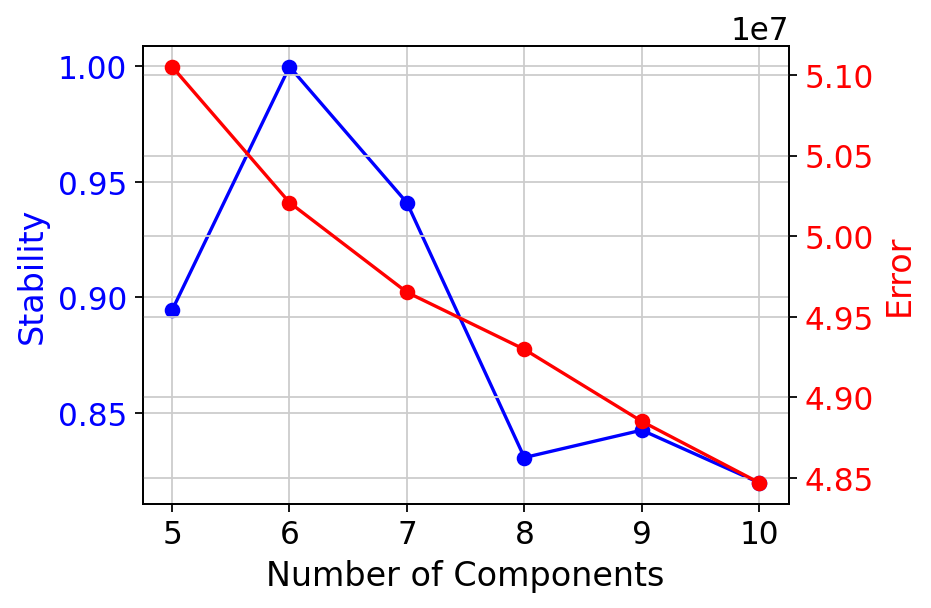

In [18]:
cnmf_obj.k_selection_plot(close_fig=False)

In [19]:
print('This saves the corresponding figure to the following file: %s' % cnmf_obj.paths['k_selection_plot'])


This saves the corresponding figure to the following file: cNMF/uro_cNMF/uro_cNMF.k_selection.png


In [20]:
kselect_plot_cmd = 'cnmf k_selection_plot --output-dir example_PBMC/cNMF --name pbmc_cNMF'
print('K selection plot command: %s' % kselect_plot_cmd)
#!{kselect_plot_cmd}

K selection plot command: cnmf k_selection_plot --output-dir example_PBMC/cNMF --name pbmc_cNMF


In [ ]:
######################################################

In [21]:
selected_K = 9
density_threshold = 2.00

/home/jupyter/.local/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


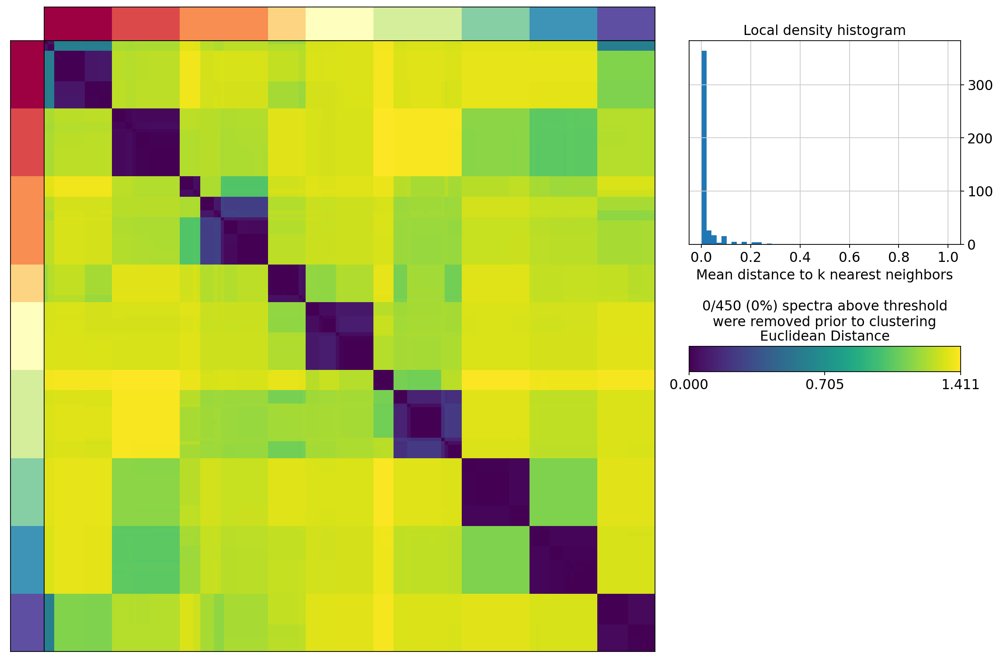

In [22]:
cnmf_obj.consensus(k=selected_K, density_threshold=density_threshold, show_clustering=True, close_clustergram_fig=False)


In [23]:
density_threshold = 0.10

/home/jupyter/.local/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


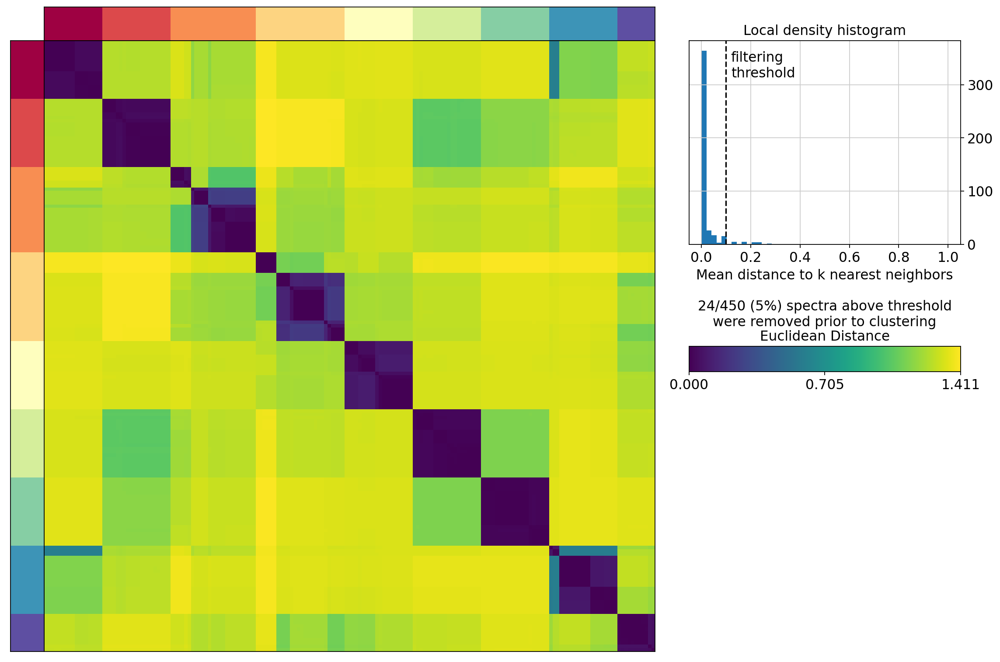

In [24]:
cnmf_obj.consensus(k=selected_K, density_threshold=density_threshold, show_clustering=True, close_clustergram_fig=False)


In [25]:
!ls ./cNMF

counts.h5ad  uro_cNMF


In [26]:
adata = sc.read(countfn)

normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


/home/jupyter/.local/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    with n_comps=50
    finished (0:00:05)


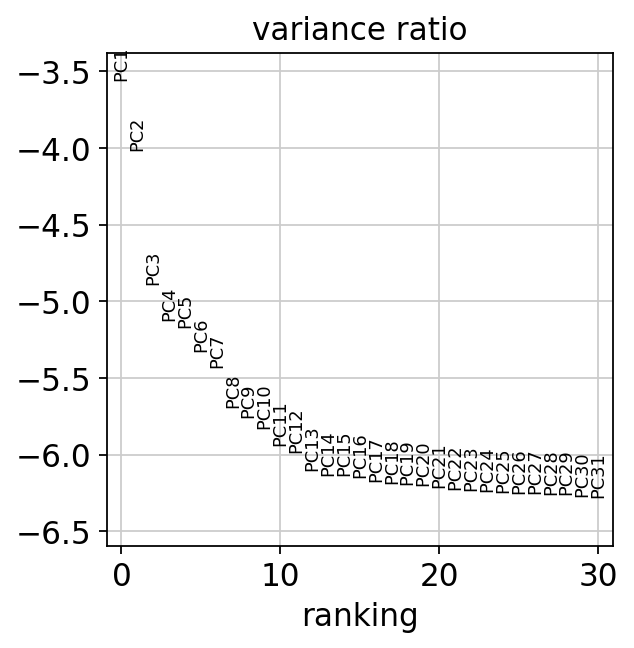

In [27]:
hvgs = open('cNMF/uro_cNMF/uro_cNMF.overdispersed_genes.txt').read().split('\n')
sc.pp.normalize_per_cell(adata, counts_per_cell_after=10**4) ## TPT normalization
adata.raw = sc.pp.log1p(adata.copy(), copy=True)
adata = adata[:,hvgs]
sc.pp.scale(adata)

## Run PCA

sc.pp.pca(adata)

## Make a scree plot to determine number of PCs to use for UMAP

sc.pl.pca_variance_ratio(adata, log=True)

computing neighbors
    using 'X_pca' with n_pcs = 15
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:38)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:36)


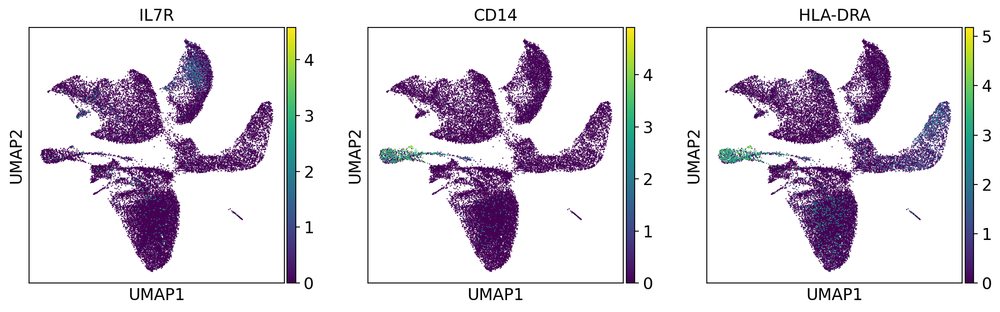

In [28]:
sc.pp.neighbors(adata, n_neighbors=50, n_pcs=15)

sc.tl.umap(adata)

sc.pl.umap(adata, color=['IL7R',
                          'CD14', 'HLA-DRA'],
           use_raw=True, ncols=3)



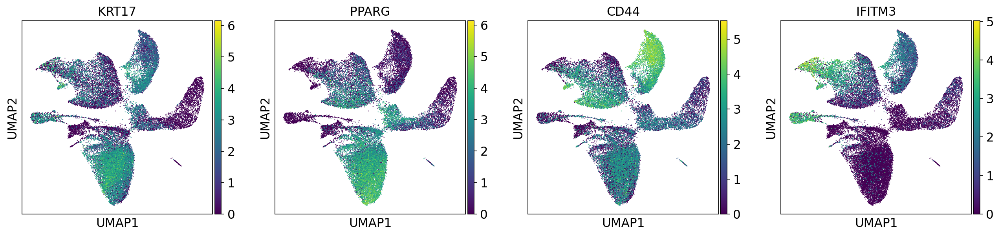

In [43]:
sc.pl.umap(adata, color=['KRT17','PPARG',
                          'CD44', 'IFITM3'],
           use_raw=True, ncols=4)

In [30]:
usage_norm, gep_scores, gep_tpm, topgenes = cnmf_obj.load_results(K=selected_K, density_threshold=density_threshold)
usage_norm.columns = ['Usage_%d' % i for i in usage_norm.columns]

In [31]:
usage_file = cnmf_obj.paths['consensus_usages__txt'] % (selected_K, '0_1')
print(usage_file)

cNMF/uro_cNMF/uro_cNMF.usages.k_9.dt_0_1.consensus.txt


In [32]:
gene_scores_file = cnmf_obj.paths['gene_spectra_score__txt'] % (selected_K, '0_1')
print(gene_scores_file)

cNMF/uro_cNMF/uro_cNMF.gene_spectra_score.k_9.dt_0_1.txt


In [33]:
gene_tpm_file = cnmf_obj.paths['gene_spectra_tpm__txt'] % (selected_K, '0_1')
print(gene_tpm_file)

cNMF/uro_cNMF/uro_cNMF.gene_spectra_tpm.k_9.dt_0_1.txt


In [34]:
adata.obs = pd.merge(left=adata.obs, right=usage_norm, how='left', left_index=True, right_index=True)


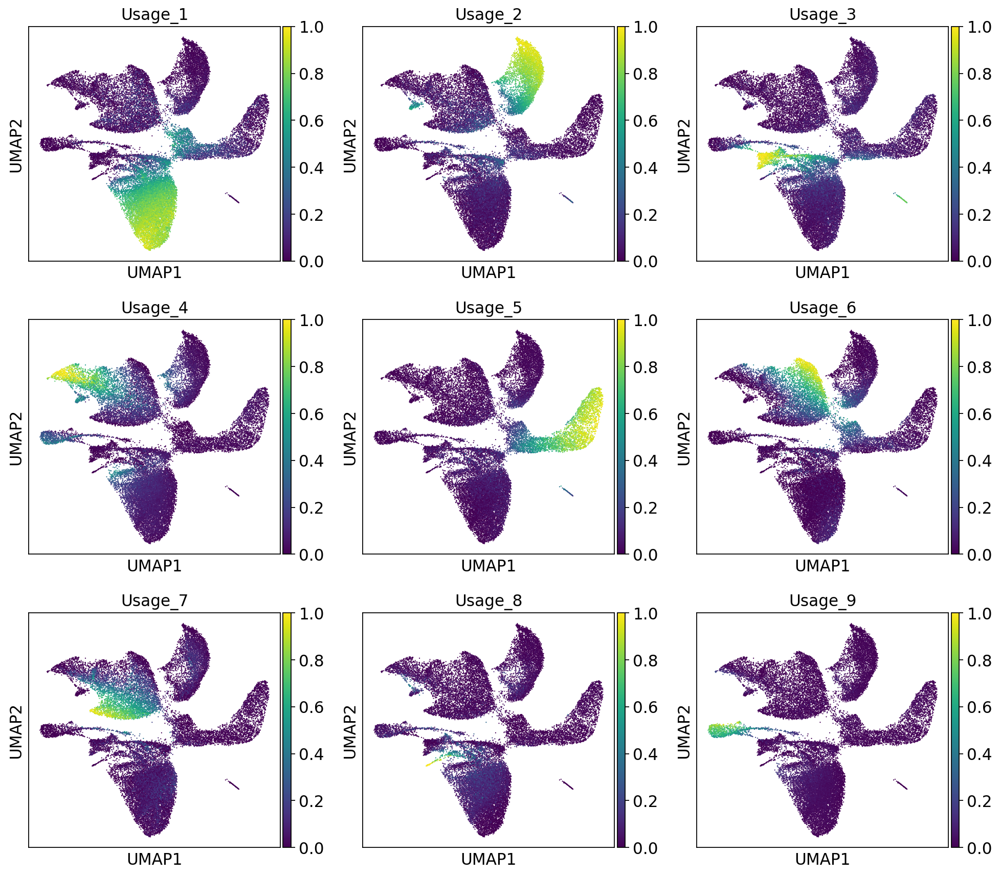

In [35]:
sc.pl.umap(adata, color=usage_norm.columns,
           use_raw=True, ncols=3, vmin=0, vmax=1)

In [36]:
topgenes.head(20)

,1,2,3,4,5,6,7,8,9
0,PDE10A,LINC01239,RBFOX1,S100A11,BMPR1B,MUC16,LAMC2,ACTG2,CD14
1,MAST4,LINC02241,DLG2,RPL8,ARHGEF38,NEBL,LAMB3,MYL9,C1QA
2,ARHGAP42,PCDH9,AGBL4,TMSB4X,SLC26A4,SAT1,LAMA3,TPM2,C1QB
3,ACER2,CD44,ANKS1B,RPS3,TTC6,SCEL,TNS4,TAGLN,HLA-DRA
4,HPGD,TLL1,EYS,RPS2,SFMBT2,PARP14,UPP1,CNN1,TIMP1
5,CCSER1,EGFR,ZFPM2,LY6E,ANKH,RNF213,EMP1,PPP1R14A,VIM
6,GAREM1,TP63,CTNNA3,RPL10,XBP1,MACC1,SLC20A1,PCP4,CTSB
7,PPARG,MIR205HG,SOX5,B2M,CSGALNACT1,DHRS9,DPP6,ACTA2,FN1
8,CD55,HGF,NEGR1,PTMA,LDLRAD4,FRMD3,SERPINB5,FLNC,CD74
9,AC019117.2,NIPSNAP2,GPC6,IFITM3,KIAA1324,MUC4,IL1A,RAMP1,HLA-DRB1


In [37]:
adata.obs['response']=np.where(adata.obs['batch'].isin(['0','1','2','3','6','7','8','9']), 'Non-Responder','Responder')


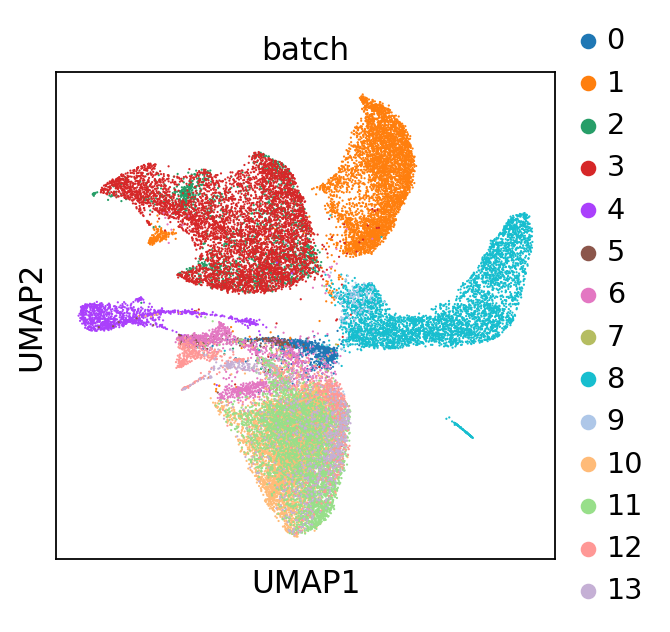

In [38]:
sc.pl.umap(adata, color = ['batch'])

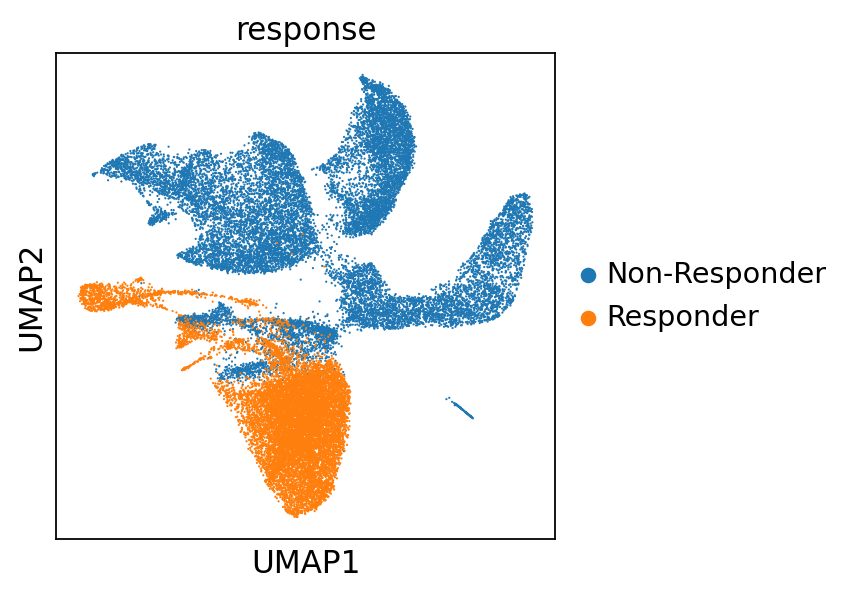

In [39]:
sc.pl.umap(adata, color = ['response'])

In [40]:
top_genes = []
ngenes = 1000
for gep in gep_scores.columns:
    top_genes.append(list(gep_scores.sort_values(by=gep, ascending=False).index[:ngenes]))

top_genes = pd.DataFrame(top_genes, index=gep_scores.columns).T

top_genes

,1,2,3,4,5,6,7,8,9
0,PDE10A,LINC01239,RBFOX1,S100A11,BMPR1B,MUC16,LAMC2,ACTG2,CD14
1,MAST4,LINC02241,DLG2,RPL8,ARHGEF38,NEBL,LAMB3,MYL9,C1QA
2,ARHGAP42,PCDH9,AGBL4,TMSB4X,SLC26A4,SAT1,LAMA3,TPM2,C1QB
3,ACER2,CD44,ANKS1B,RPS3,TTC6,SCEL,TNS4,TAGLN,HLA-DRA
4,HPGD,TLL1,EYS,RPS2,SFMBT2,PARP14,UPP1,CNN1,TIMP1
...,...,...,...,...,...,...,...,...,...
995,KRT23,PEX10,SLC18A2,MGAT4B,STXBP5L,NFKB2,CNOT9,ABHD17A,CCN2
996,ZDHHC11B,CAAP1,PRTG,ALYREF,PIAS1,DHX32,ANO9,PDHB,MRPL12
997,TRERF1,ZNF131,ADA2,ATMIN,JAK1,FAM102A,CCNG2,MYL12A,STUB1
998,RAB3GAP1,TMEM135,AC004797.1,CERS2,CLASP1,FUT2,QTRT1,ERLIN2,CD163L1


In [41]:
pd.set_option('display.max_rows', 500)
top_genes.head(50)

,1,2,3,4,5,6,7,8,9
0,PDE10A,LINC01239,RBFOX1,S100A11,BMPR1B,MUC16,LAMC2,ACTG2,CD14
1,MAST4,LINC02241,DLG2,RPL8,ARHGEF38,NEBL,LAMB3,MYL9,C1QA
2,ARHGAP42,PCDH9,AGBL4,TMSB4X,SLC26A4,SAT1,LAMA3,TPM2,C1QB
3,ACER2,CD44,ANKS1B,RPS3,TTC6,SCEL,TNS4,TAGLN,HLA-DRA
4,HPGD,TLL1,EYS,RPS2,SFMBT2,PARP14,UPP1,CNN1,TIMP1
5,CCSER1,EGFR,ZFPM2,LY6E,ANKH,RNF213,EMP1,PPP1R14A,VIM
6,GAREM1,TP63,CTNNA3,RPL10,XBP1,MACC1,SLC20A1,PCP4,CTSB
7,PPARG,MIR205HG,SOX5,B2M,CSGALNACT1,DHRS9,DPP6,ACTA2,FN1
8,CD55,HGF,NEGR1,PTMA,LDLRAD4,FRMD3,SERPINB5,FLNC,CD74
9,AC019117.2,NIPSNAP2,GPC6,IFITM3,KIAA1324,MUC4,IL1A,RAMP1,HLA-DRB1


In [45]:
#save top genes for each usage to a CSV for downstream GSEA
top_genes.to_csv("top_program_genes_cnmf_UrothelialONLY_nonharmonized.csv", header=True)
!gsutil cp top_program_genes_cnmf_UrothelialONLY_nonharmonized.csv $bucket/cellranger_output_directory/bladder/cnmf/


Copying file://top_program_genes_cnmf_UrothelialONLY_nonharmonized.csv [Content-Type=text/csv]...
/ [1 files][ 61.9 KiB/ 61.9 KiB]                                                
Operation completed over 1 objects/61.9 KiB.                                     


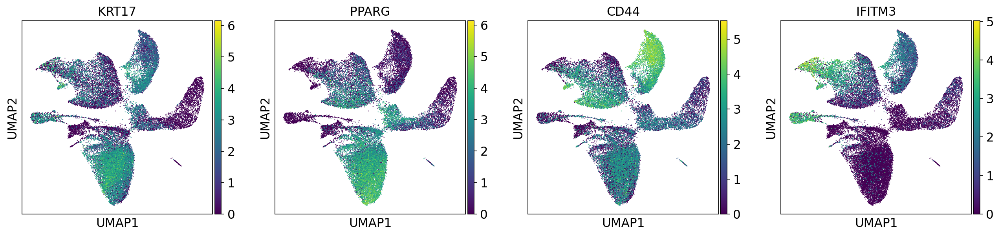

In [44]:
sc.pl.umap(adata, color=['KRT17','PPARG','CD44',"IFITM3"],
           use_raw=True, ncols=4)

In [46]:
adata

AnnData object with n_obs × n_vars = 30444 × 2000
    obs: 'doublet_score', 'predicted_doublet', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_mt', 'pct_counts_mt', 'platelet', 'RBC', 'batch', 'n_counts', 'Usage_1', 'Usage_2', 'Usage_3', 'Usage_4', 'Usage_5', 'Usage_6', 'Usage_7', 'Usage_8', 'Usage_9', 'response'
    var: 'mt', 'ribo', 'n_cells', 'mean', 'std'
    uns: 'pca', 'neighbors', 'umap', 'batch_colors', 'response_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

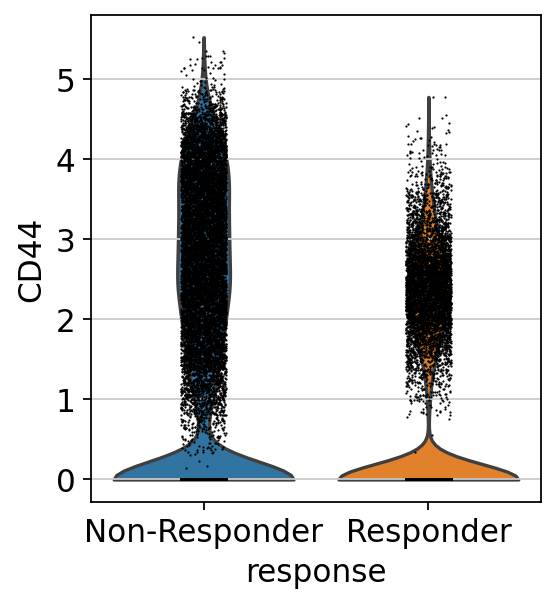

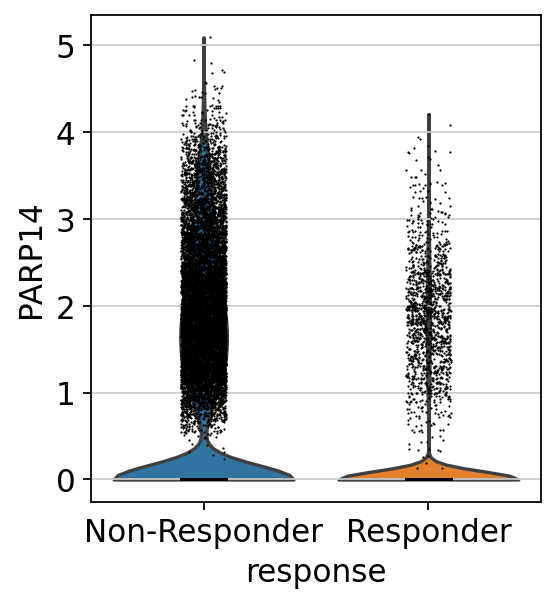

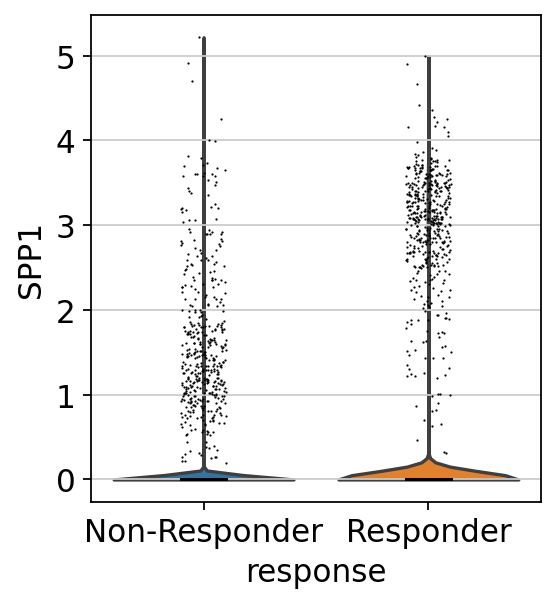

In [47]:
sc.pl.violin(adata, 'CD44', groupby= 'response', log=False, use_raw=None, stripplot=True, jitter=True, size=1, layer=None, scale='width', order=None, multi_panel=None, xlabel='', ylabel=None, rotation=None, show=None, save=None, ax=None)
sc.pl.violin(adata, 'PARP14', groupby= 'response', log=False, use_raw=None, stripplot=True, jitter=True, size=1, layer=None, scale='width', order=None, multi_panel=None, xlabel='', ylabel=None, rotation=None, show=None, save=None, ax=None)
sc.pl.violin(adata, 'SPP1', groupby= 'response', log=False, use_raw=None, stripplot=True, jitter=True, size=1, layer=None, scale='width', order=None, multi_panel=None, xlabel='', ylabel=None, rotation=None, show=None, save=None, ax=None)


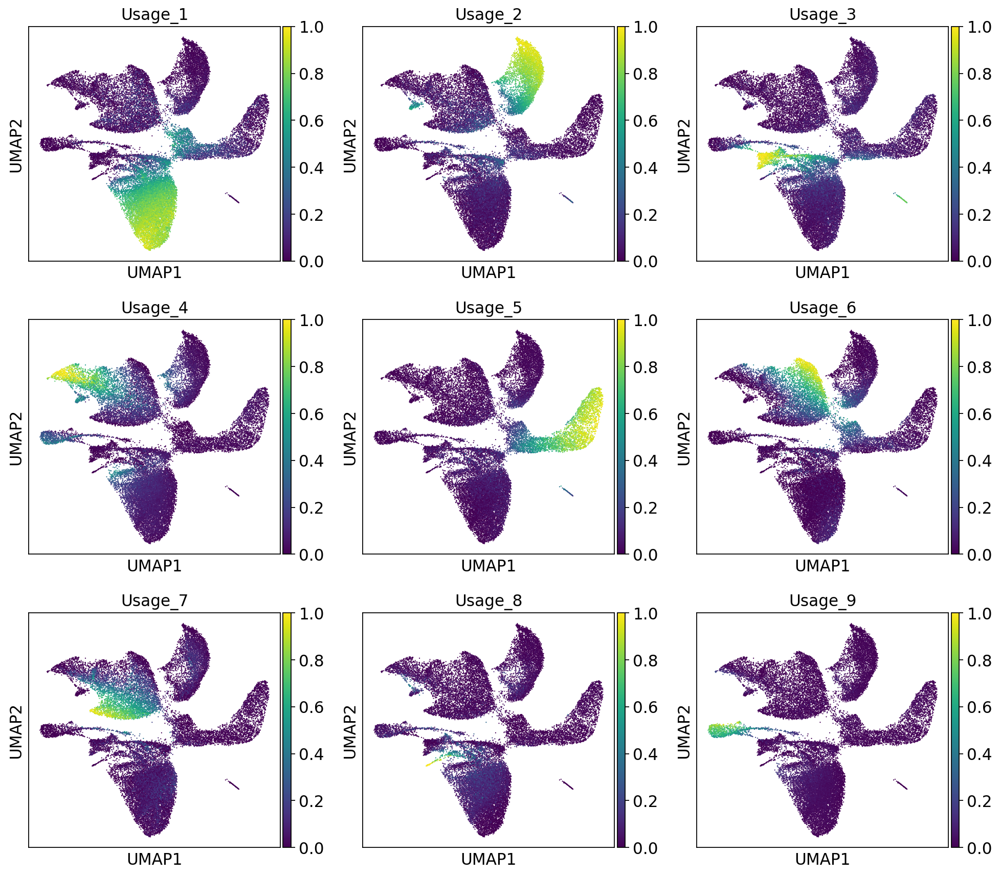

In [48]:
sc.pl.umap(adata, color=usage_norm.columns,
           use_raw=True, ncols=3, vmin=0, vmax=1)

In [49]:
# Putative regulators and downstream pathways of usage programs 1 and 3
usage_program_genes = {'Program 3': ['EGFR','CBLIF','NIPSNAP2','TTC16','MYLK3','GADL1','SVOPL','CD44','TCF4-AS2','TRIML2'],  
                       'Program 2': ['AC124014.1','IRGM','LINC00342','GPR1','MEIKIN','LINC01620','GRM7','GULP1','DPP6','C5orf52']}
usage_program2_genes={'Program 2': ['AC124014.1','IRGM','LINC00342','GPR1','MEIKIN','LINC01620','GRM7','GULP1','DPP6','C5orf52']}

usage_program3_genes={'Program 3': ['EGFR','CBLIF','NIPSNAP2','TTC16','MYLK3','GADL1','SVOPL','CD44','TCF4-AS2','TRIML2']}
                       

sc.pl.dotplot(adata, usage_program_genes, groupby='response')
sc.pl.dotplot(adata, usage_program2_genes, groupby='response')
sc.pl.dotplot(adata, usage_program3_genes, groupby='response')



'C5orf52', 'CBLIF', 'GADL1', 'GPR1', 'LINC01620', 'MYLK3', 'SVOPL', 'TCF4-AS2', 'TRIML2', 'TTC16'

KeyError: "Could not find keys '['C5orf52', 'CBLIF', 'GADL1', 'GPR1', 'LINC01620', 'MYLK3', 'SVOPL', 'TCF4-AS2', 'TRIML2', 'TTC16']' in columns of `adata.obs` or in adata.raw.var_names."